In [1]:
import pandas as pd, numpy as np
from sklearn.model_selection import KFold, GroupKFold
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn.metrics import f1_score

In [2]:
# train = pd.read_csv('/kaggle/input/predict-student-performance-from-game-play/train.csv')
train = pd.read_csv('c:/team_ho/PredictStudentPerformanceFromGamePlay/data/train.csv')

# NaN값 처리
train['room_coor_x'] = train['room_coor_x'].fillna(0)
train['room_coor_y'] = train['room_coor_y'].fillna(0)
train['screen_coor_x'] = train['screen_coor_x'].fillna(0)
train['screen_coor_y'] = train['screen_coor_y'].fillna(0)
train['hover_duration'] = train['hover_duration'].fillna(0)
train['page'] = train['page'].fillna(-1)

In [3]:
# targets = pd.read_csv('/kaggle/input/predict-student-performance-from-game-play/train_labels.csv')
targets = pd.read_csv('c:/team_ho/PredictStudentPerformanceFromGamePlay/data/train_labels.csv')

targets['session'] = targets.session_id.apply(lambda x: int(x.split('_')[0]) )
targets['q'] = targets.session_id.apply(lambda x: int(x.split('_')[-1][1:]) )

# Columns

session_id - 이벤트가 발생한 세션의 ID  
index - 세션의 이벤트 인덱스  
elapsed_time - 세션 시작과 이벤트가 기록된 시간 사이에 경과된 시간(in milliseconds)  
event_name - 이벤트 유형의 이름  
name - 이벤트 이름(예: notebook_click이 노트북을 열거나 닫는 중인지 식별)  
level - 이벤트가 발생한 게임의 레벨(0~22)  
page - 이벤트의 페이지 번호(노트북 관련 이벤트에만 해당)  
room_coor_x - 게임 내 방을 기준으로 한 클릭 좌표(클릭 이벤트에만 해당)  
room_coor_y - 게임 내 방을 기준으로 한 클릭 좌표(클릭 이벤트에만 해당)  
screen_coor_x - 플레이어 화면을 기준으로 한 클릭 좌표(클릭 이벤트에만 해당)  
screen_coor_y - 플레이어 화면을 기준으로 한 클릭 좌표(클릭 이벤트에만 해당)  
hover_duration - 호버가 발생한 시간(in milliseconds)(호버 이벤트에만 해당)  
text - 이 이벤트 동안 플레이어에게 표시되는 텍스트  
fqid - 이벤트의 완전한 ID  
room_fqid - 이벤트가 발생한 방의 정규화된 ID  
text_fqid - 정규화된 ID  
fullscreen - 플레이어가 전체 화면 모드인지 여부  
hq - 게임이 고품질인지 여부  
music - 게임 음악이 켜져 있는지 여부  
level_group - 레벨 그룹 및 질문 그룹 - 이 행은 (0-4, 5-12, 13-22)에 속합니다.  

In [4]:
train.columns

Index(['session_id', 'index', 'elapsed_time', 'event_name', 'name', 'level',
       'page', 'room_coor_x', 'room_coor_y', 'screen_coor_x', 'screen_coor_y',
       'hover_duration', 'text', 'fqid', 'room_fqid', 'text_fqid',
       'fullscreen', 'hq', 'music', 'level_group'],
      dtype='object')

In [5]:
train.event_name.value_counts()

navigate_click        5687896
person_click          3024847
cutscene_click        1351732
object_click          1099670
object_hover           529116
map_hover              471621
notification_click     324106
notebook_click         284746
map_click              258714
observation_click      106260
checkpoint              35503
Name: event_name, dtype: int64

In [10]:
import pandas as pd, numpy as np
import matplotlib.pyplot as plt
from PIL import Image


In [9]:
ROOMS = train.room_fqid.unique()
print('Number of rooms:', len(ROOMS) )
print( ROOMS )

Number of rooms: 19
['tunic.historicalsociety.closet' 'tunic.historicalsociety.basement'
 'tunic.historicalsociety.entry' 'tunic.historicalsociety.collection'
 'tunic.historicalsociety.stacks' 'tunic.kohlcenter.halloffame'
 'tunic.capitol_0.hall' 'tunic.historicalsociety.closet_dirty'
 'tunic.historicalsociety.frontdesk' 'tunic.humanecology.frontdesk'
 'tunic.drycleaner.frontdesk' 'tunic.library.frontdesk'
 'tunic.library.microfiche' 'tunic.capitol_1.hall'
 'tunic.historicalsociety.cage' 'tunic.historicalsociety.collection_flag'
 'tunic.wildlife.center' 'tunic.flaghouse.entry' 'tunic.capitol_2.hall']




#########################
### ROOM 1: tunic.historicalsociety.closet
#########################


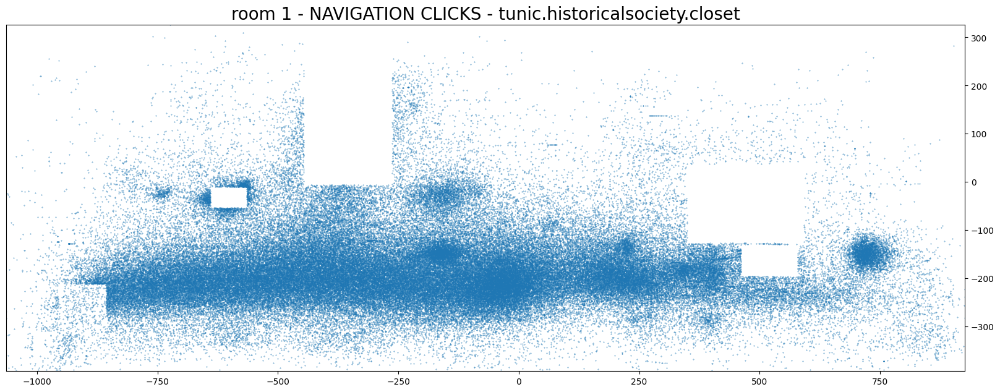

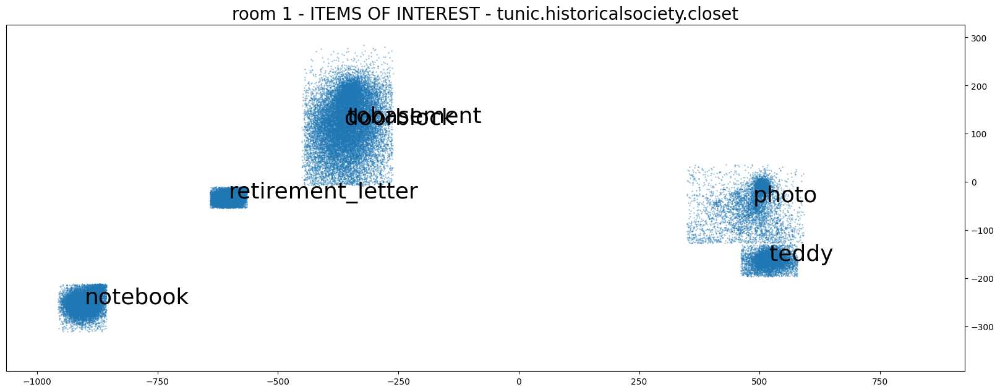

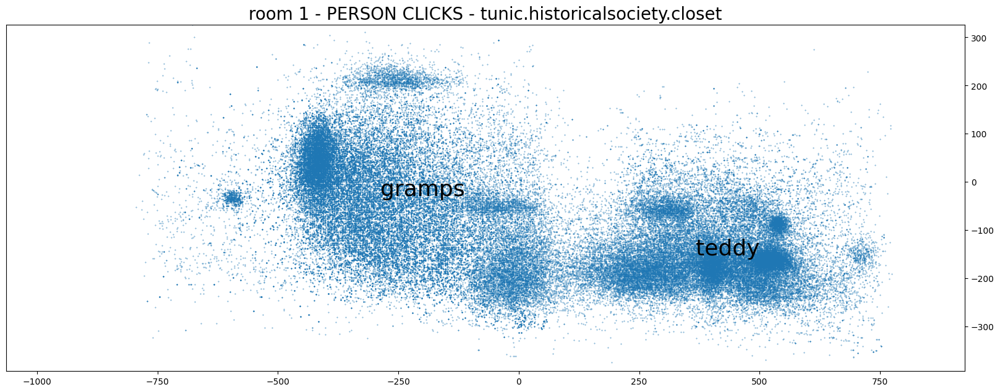



#########################
### ROOM 2: tunic.historicalsociety.basement
#########################


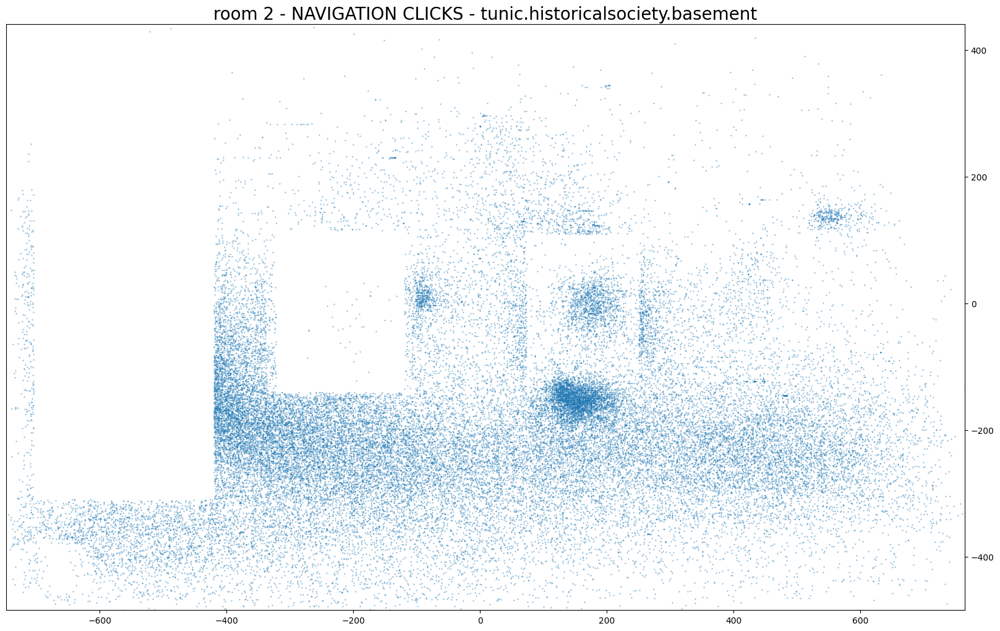

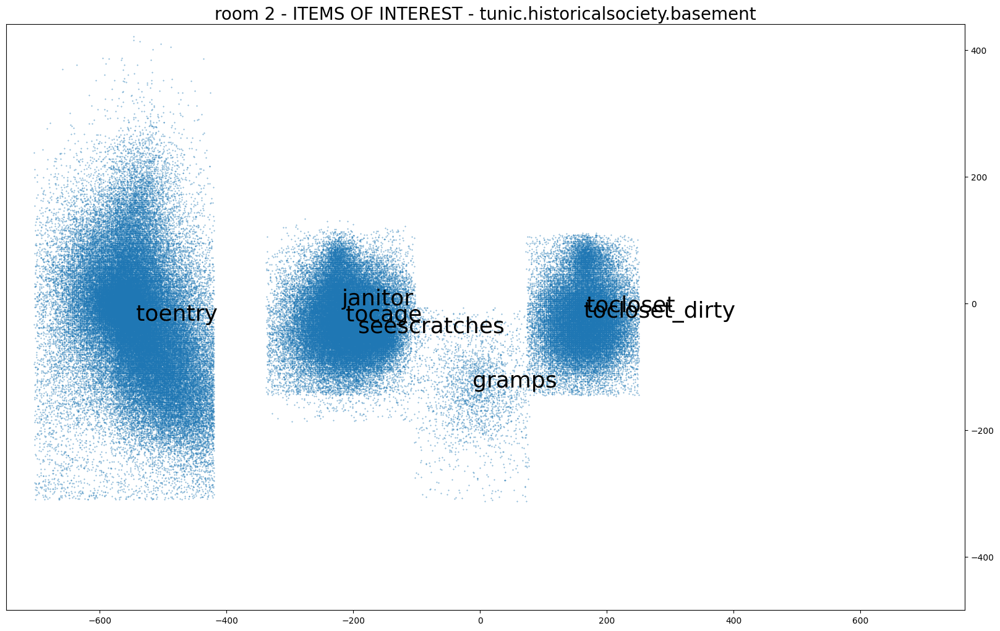

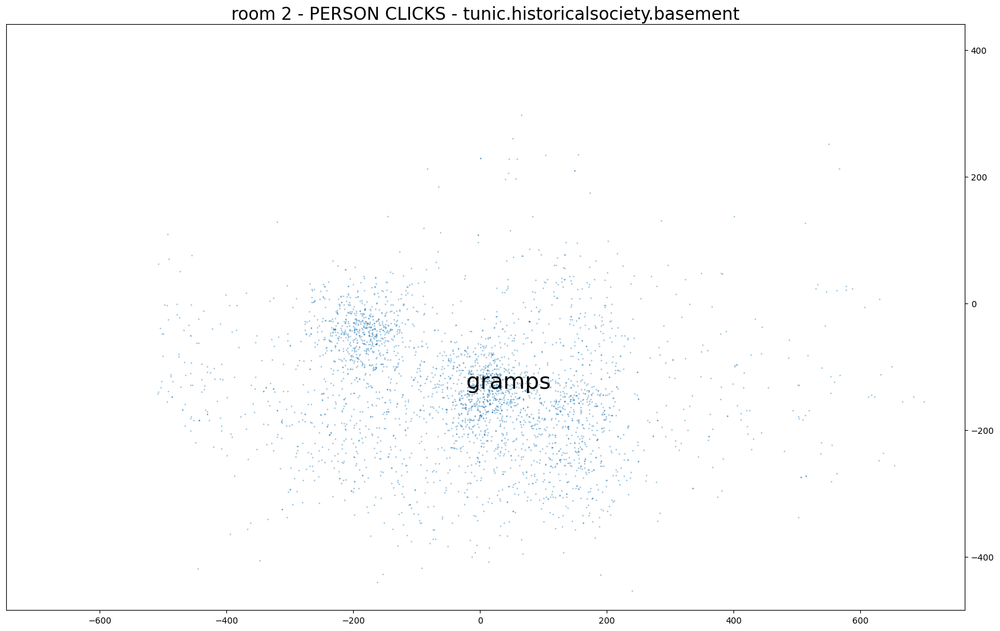



#########################
### ROOM 3: tunic.historicalsociety.entry
#########################


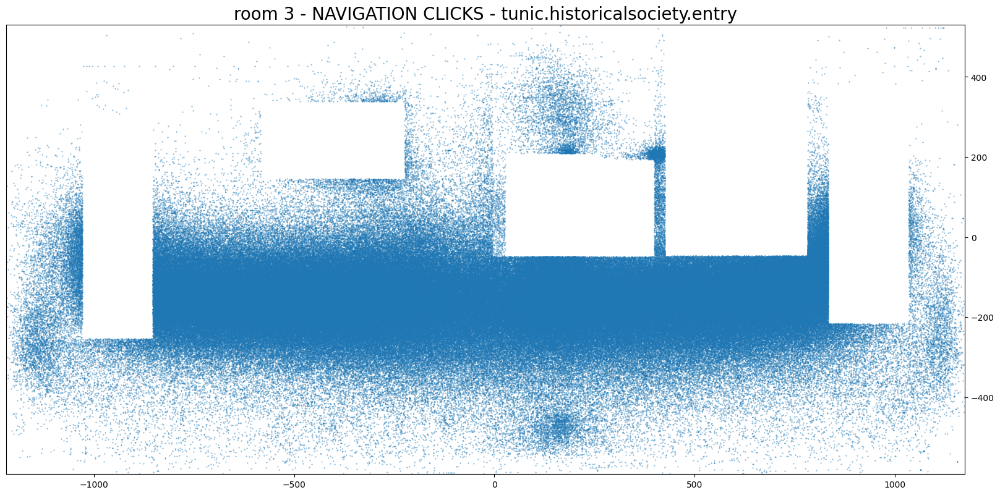

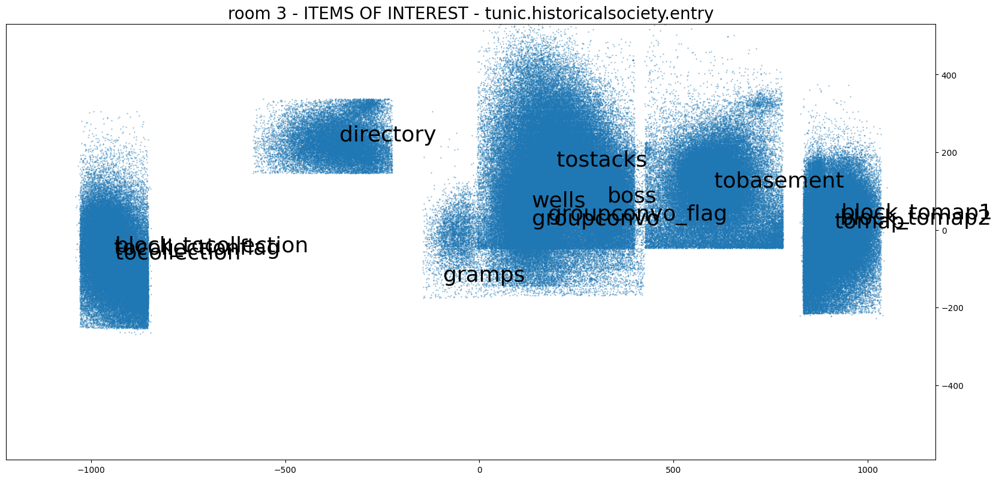

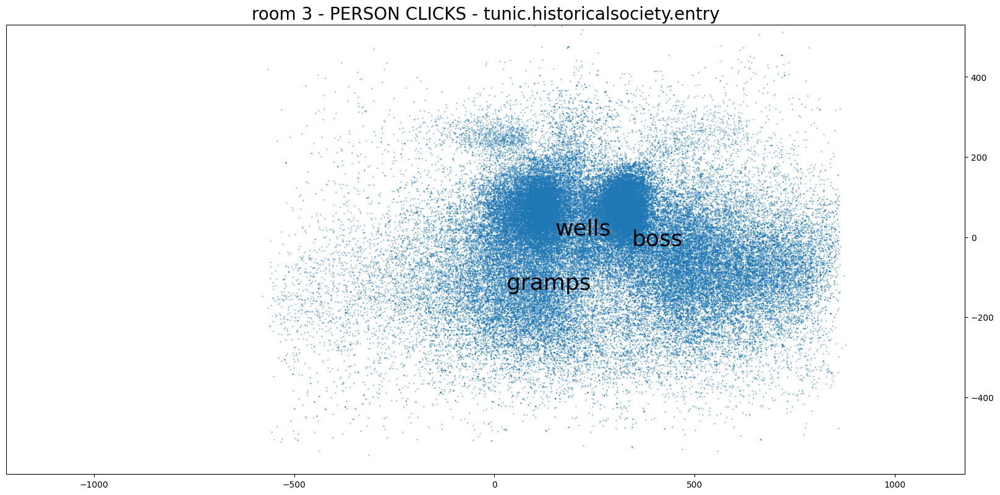



#########################
### ROOM 4: tunic.historicalsociety.collection
#########################


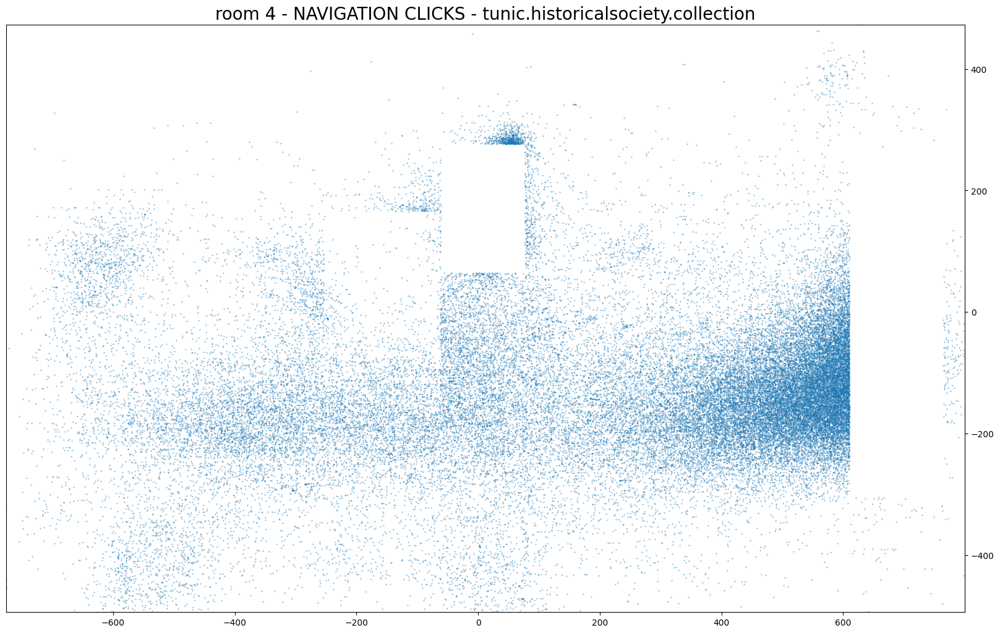

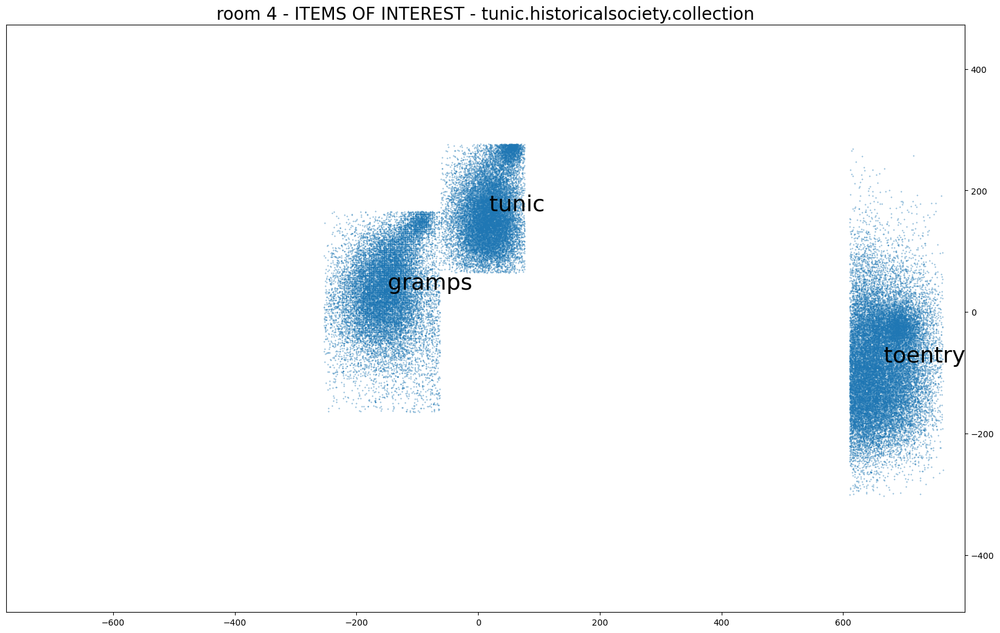

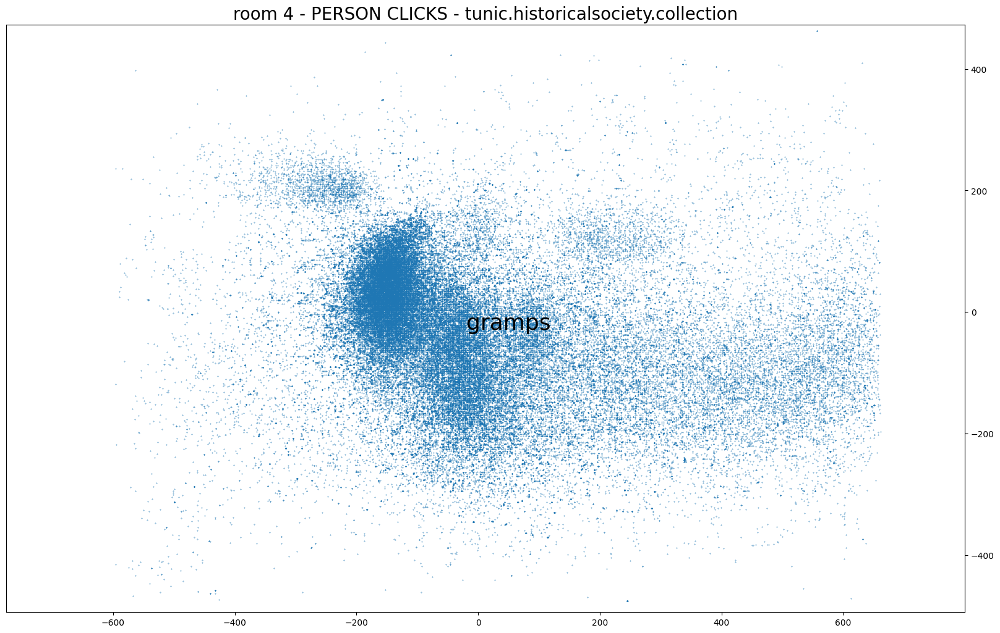



#########################
### ROOM 5: tunic.historicalsociety.stacks
#########################


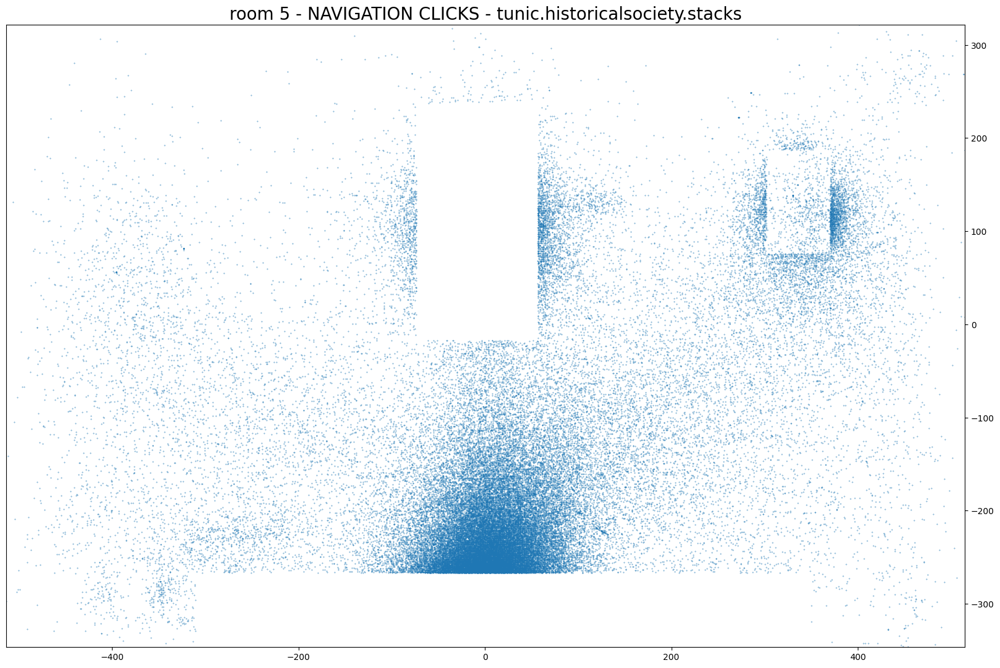

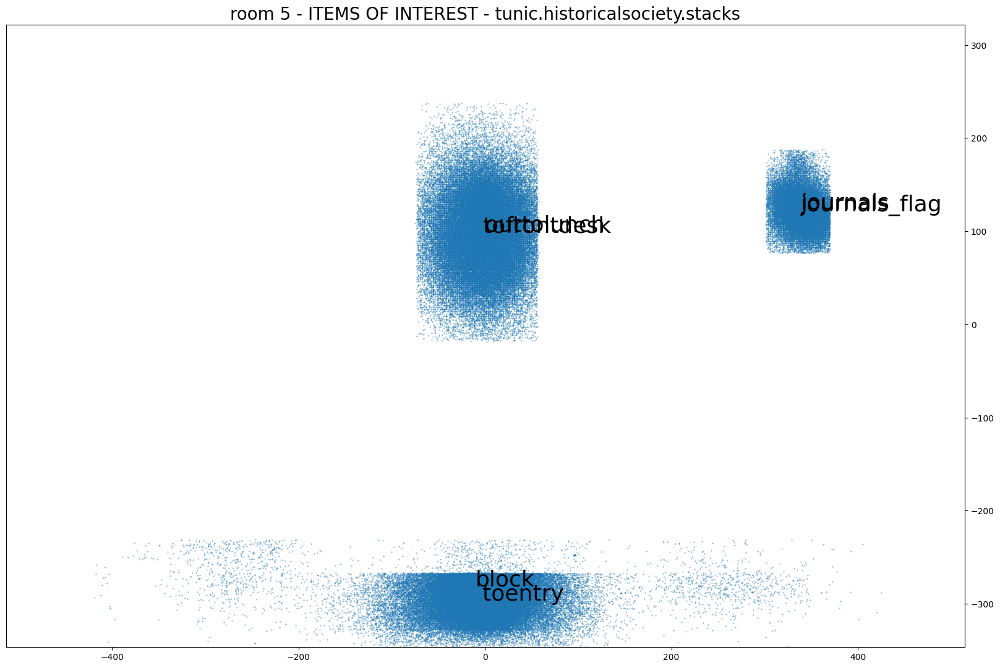



#########################
### ROOM 6: tunic.kohlcenter.halloffame
#########################


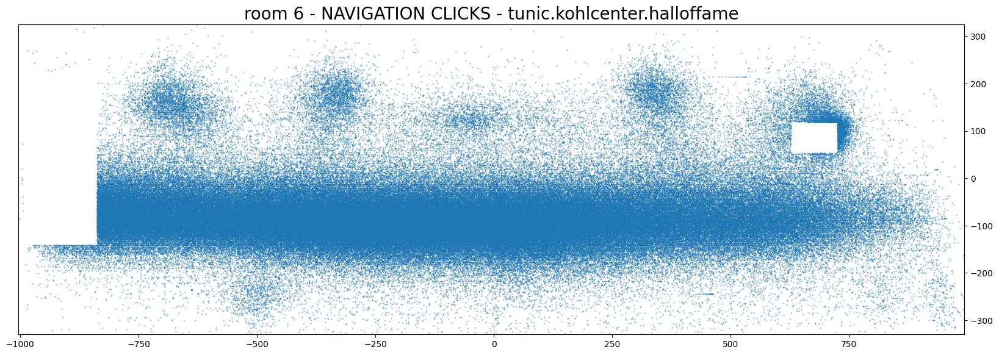

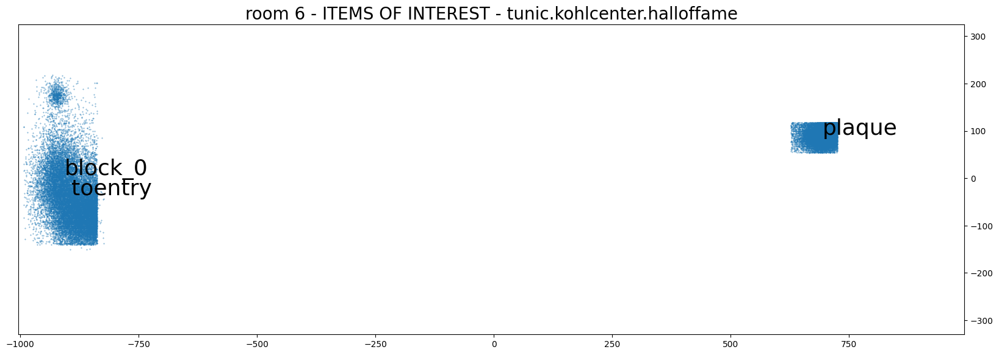



#########################
### ROOM 7: tunic.capitol_0.hall
#########################


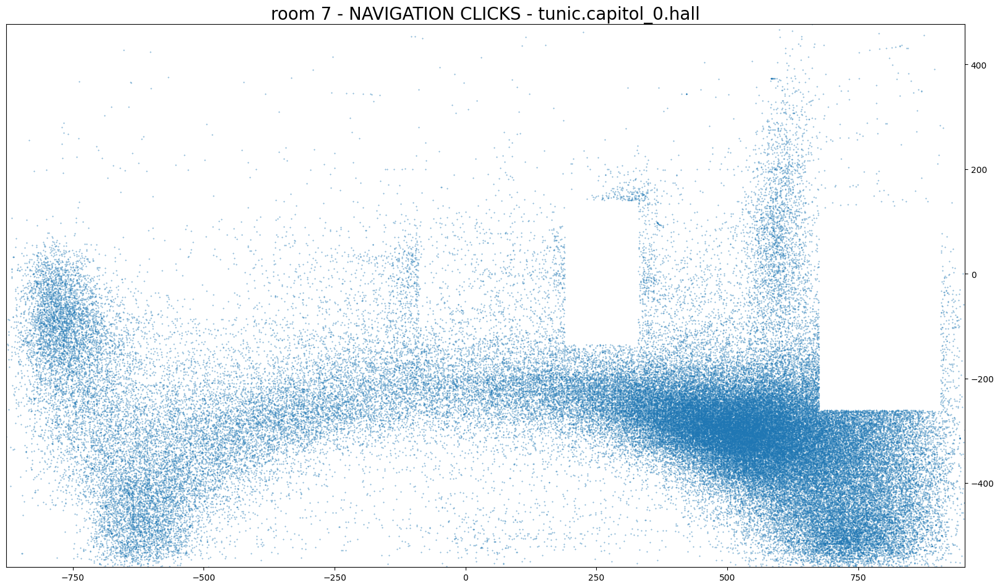

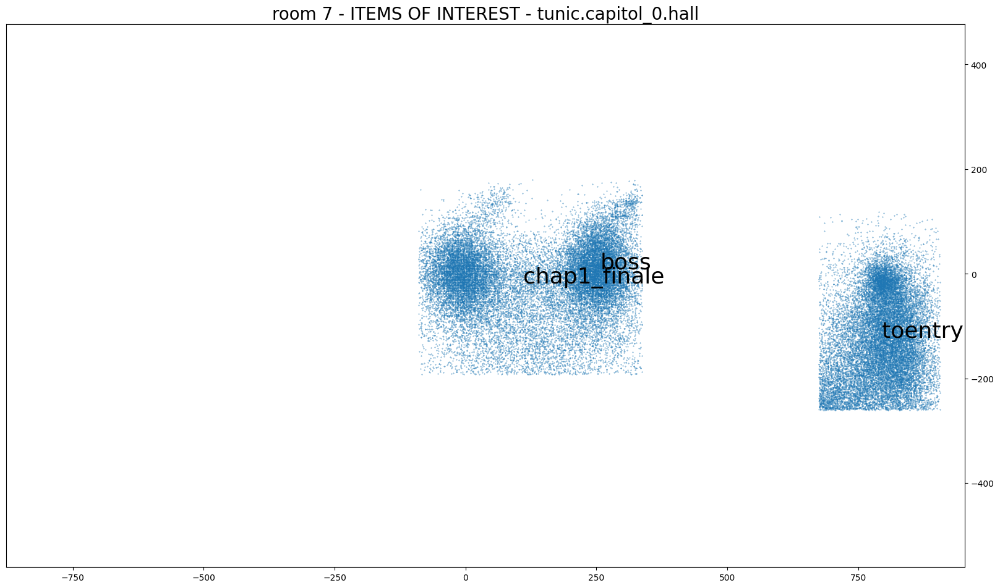

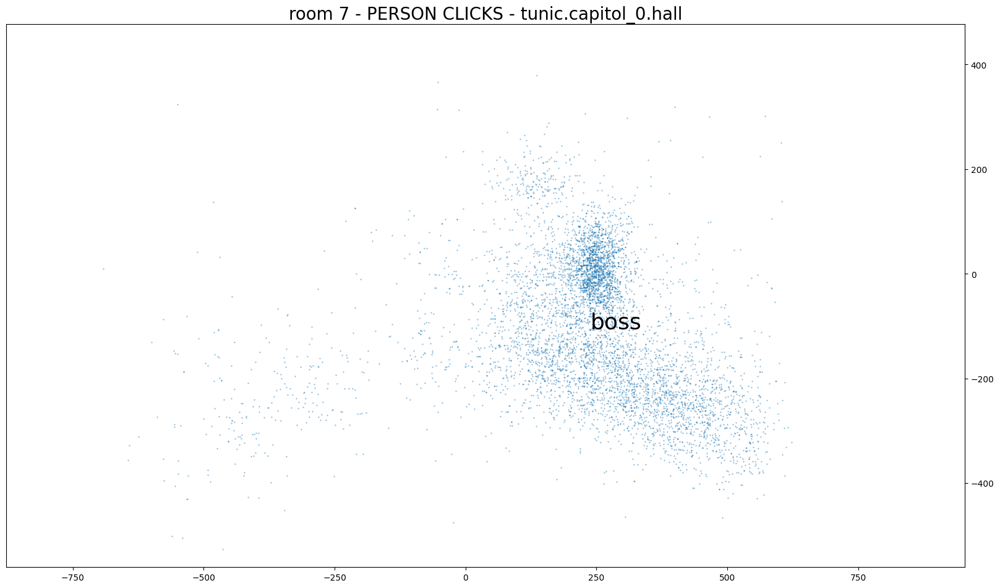



#########################
### ROOM 8: tunic.historicalsociety.closet_dirty
#########################


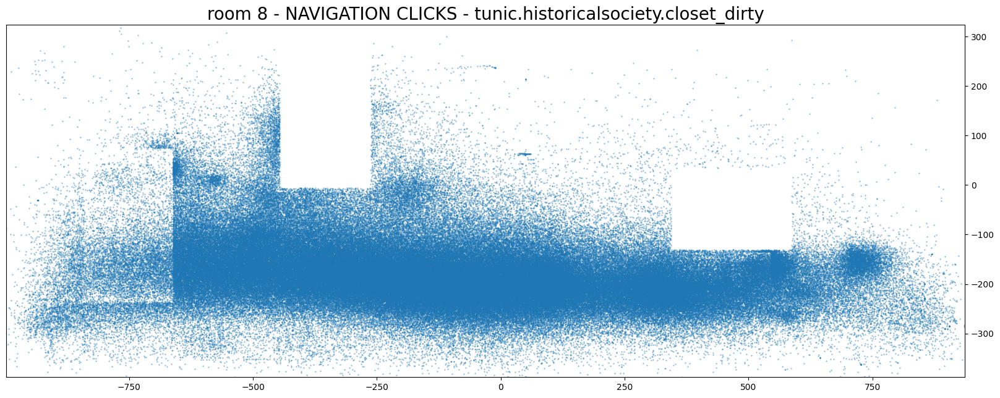

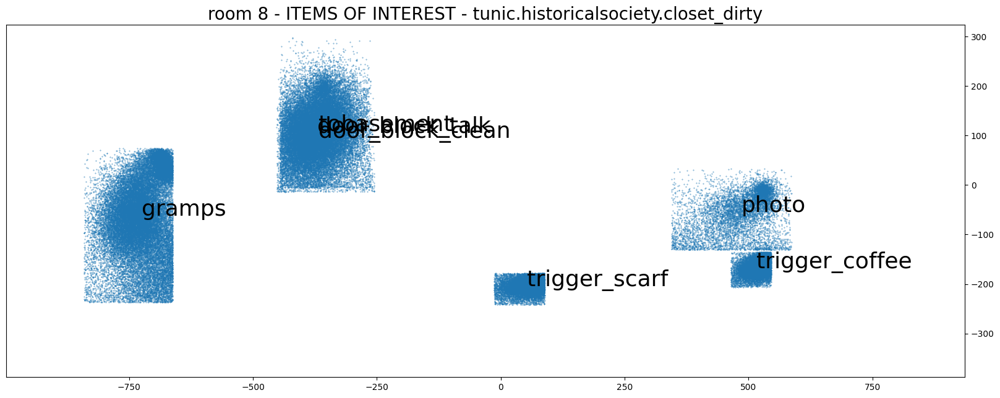

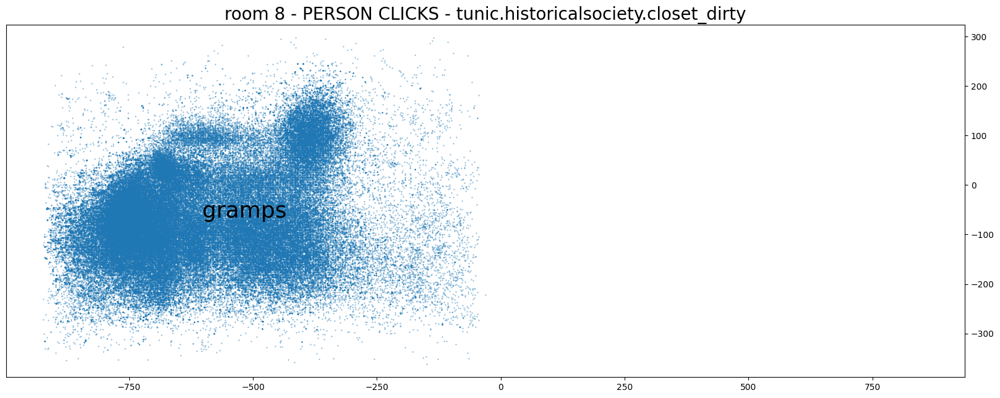



#########################
### ROOM 9: tunic.historicalsociety.frontdesk
#########################


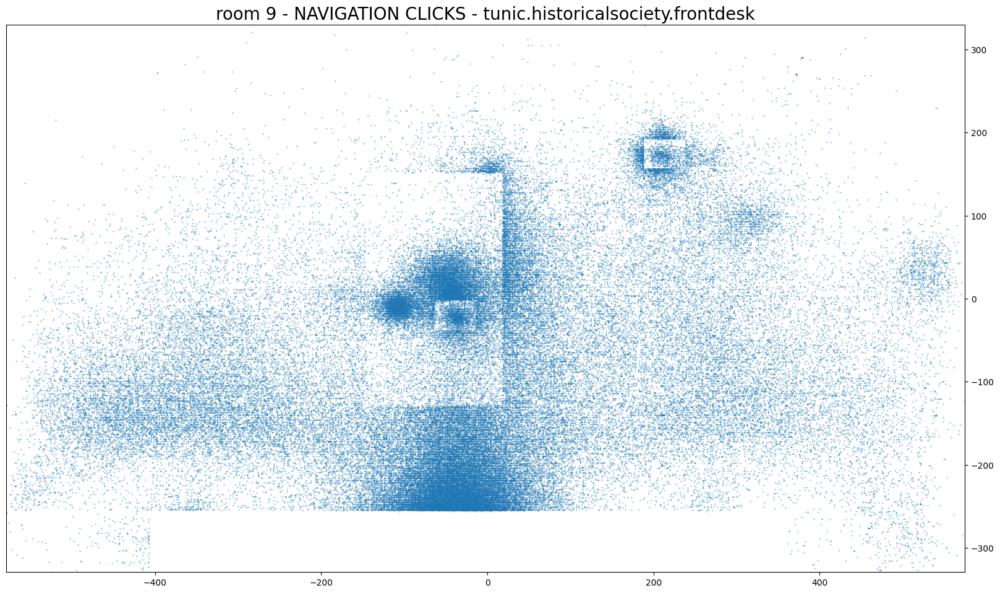

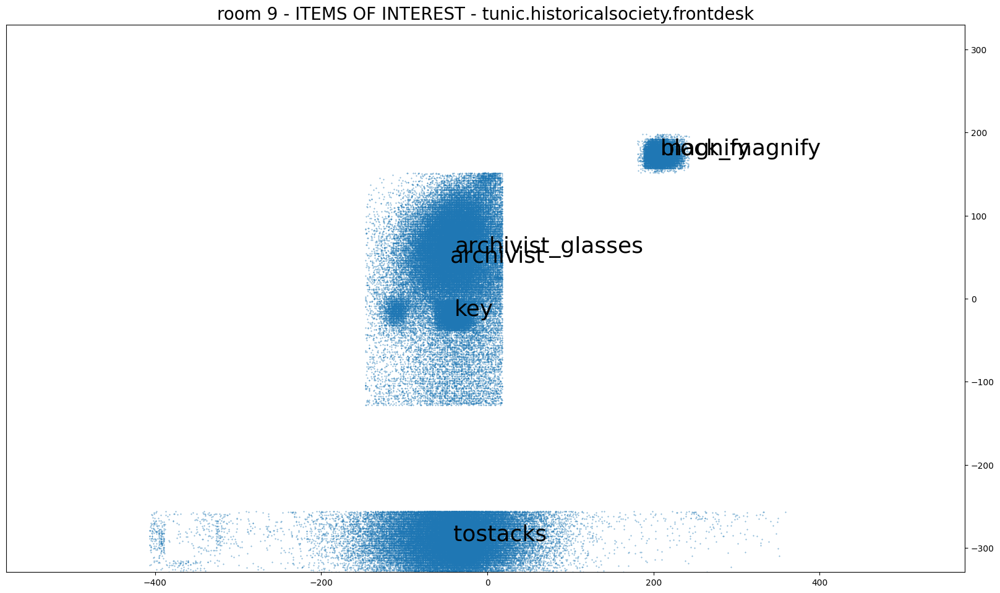

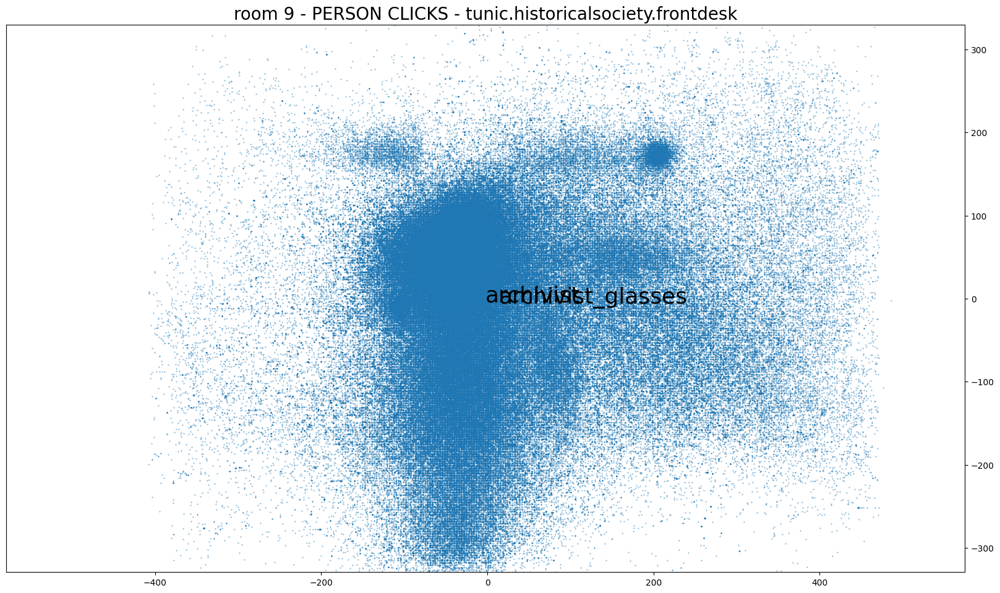



#########################
### ROOM 10: tunic.humanecology.frontdesk
#########################


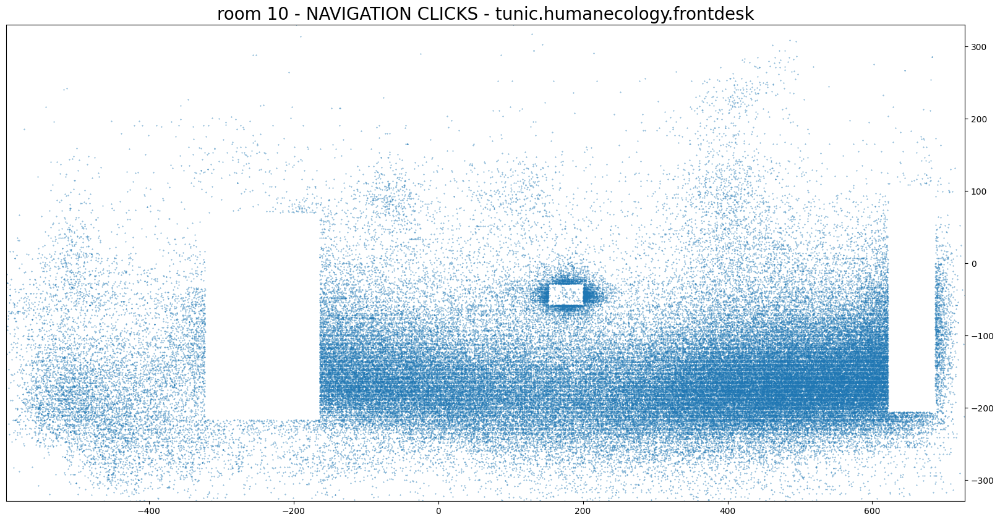

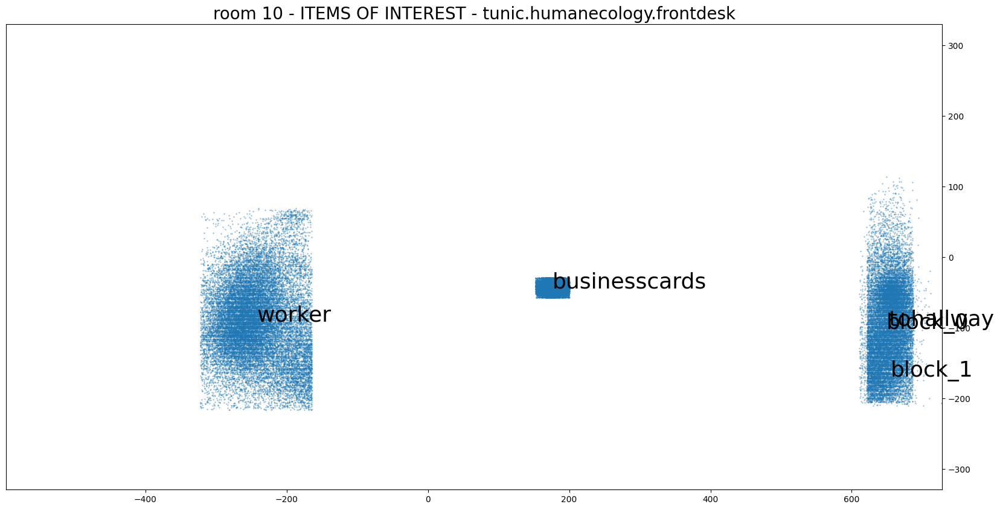

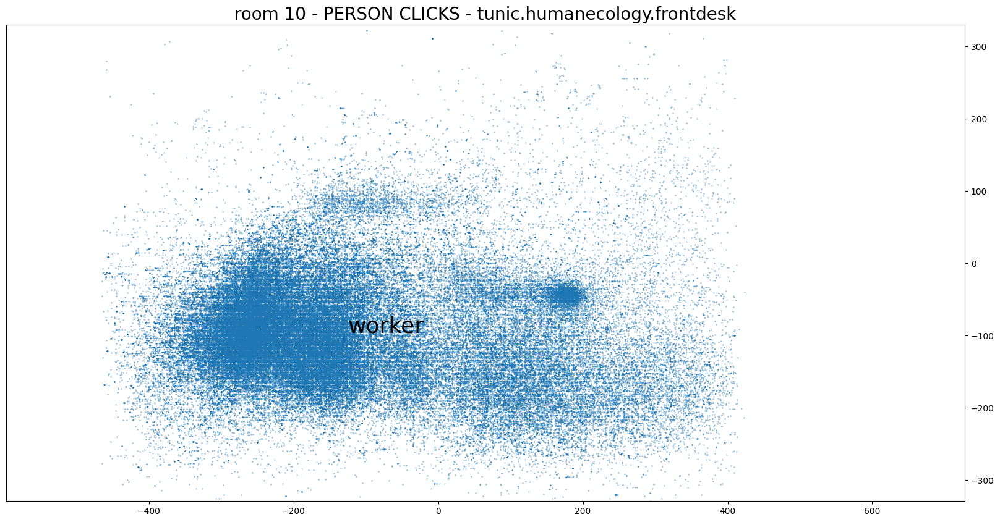



#########################
### ROOM 11: tunic.drycleaner.frontdesk
#########################


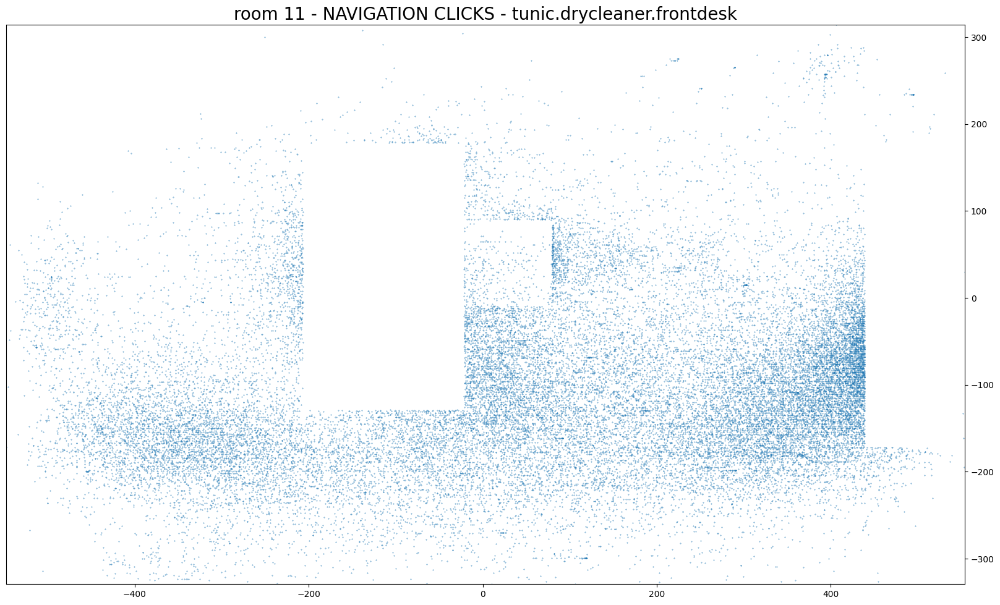

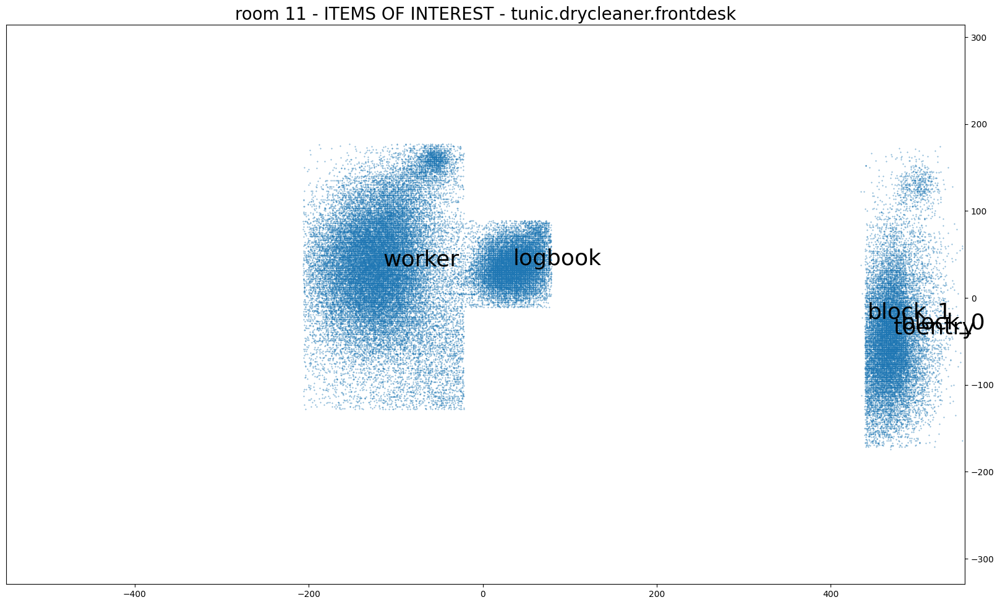

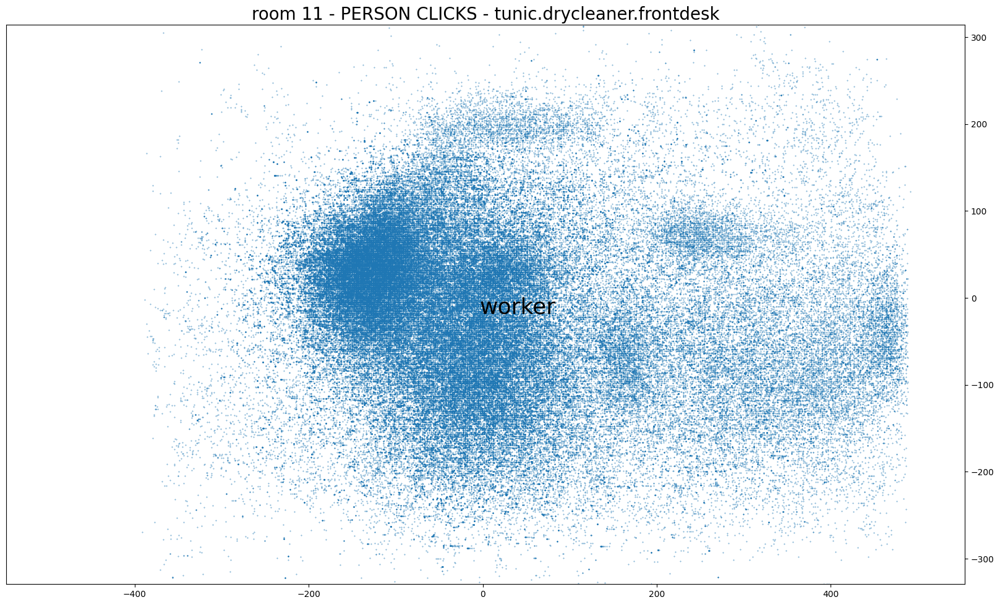



#########################
### ROOM 12: tunic.library.frontdesk
#########################


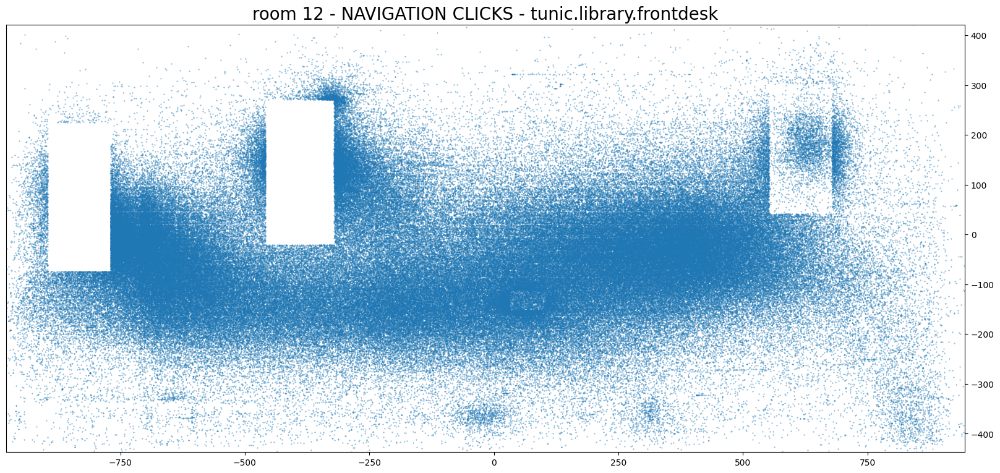

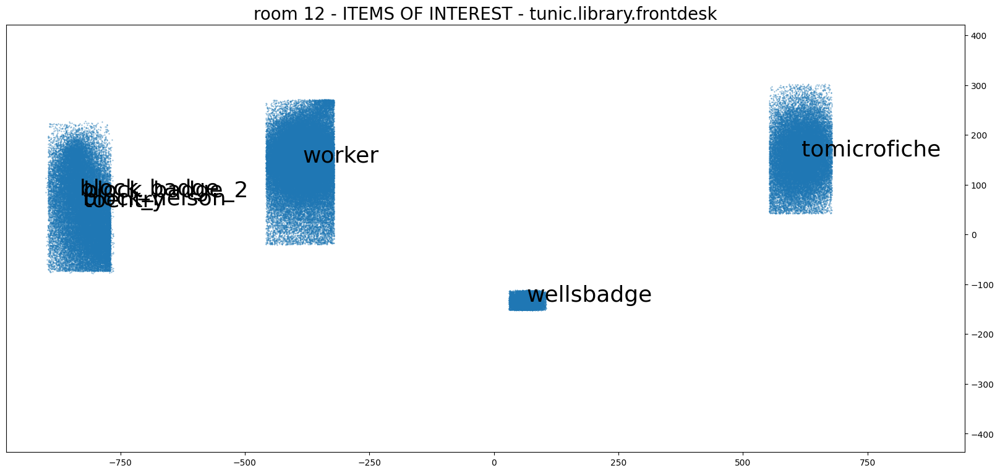

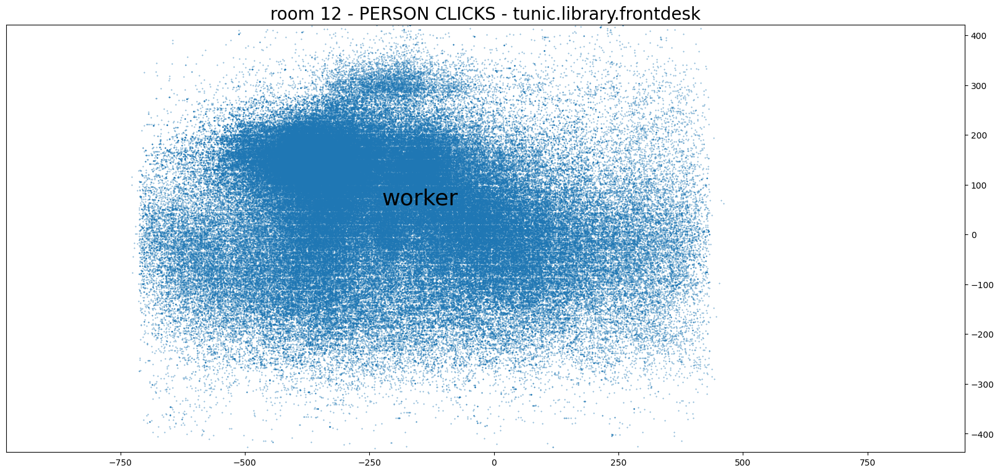



#########################
### ROOM 13: tunic.library.microfiche
#########################


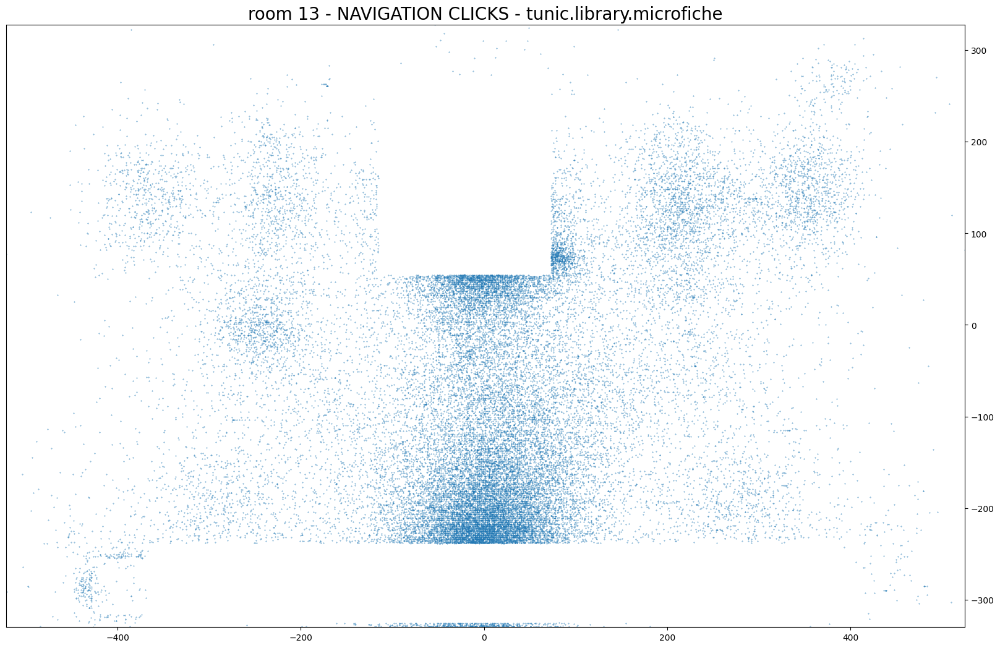

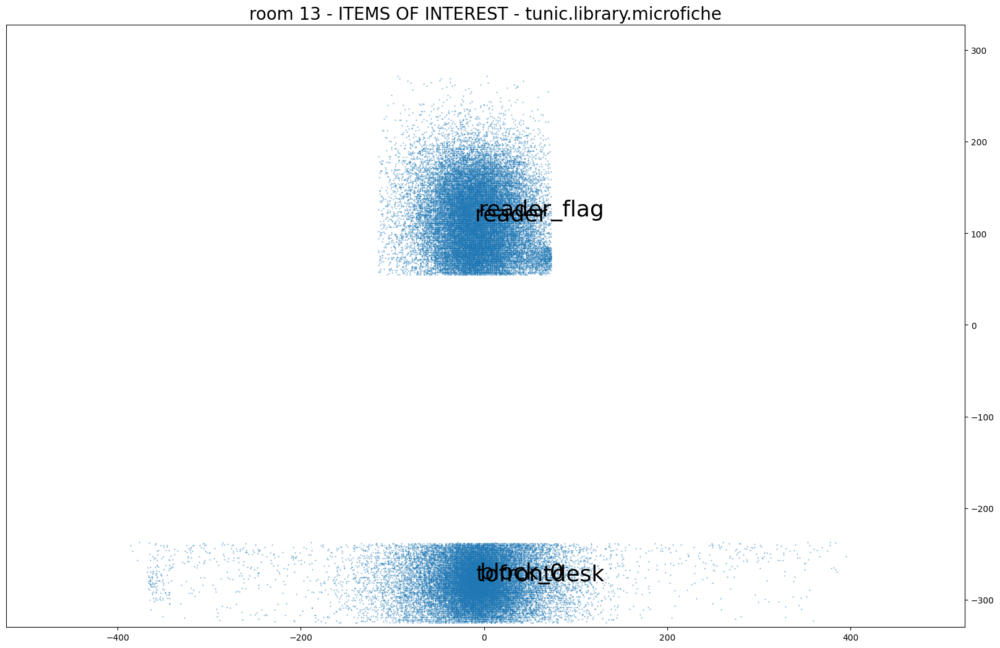



#########################
### ROOM 14: tunic.capitol_1.hall
#########################


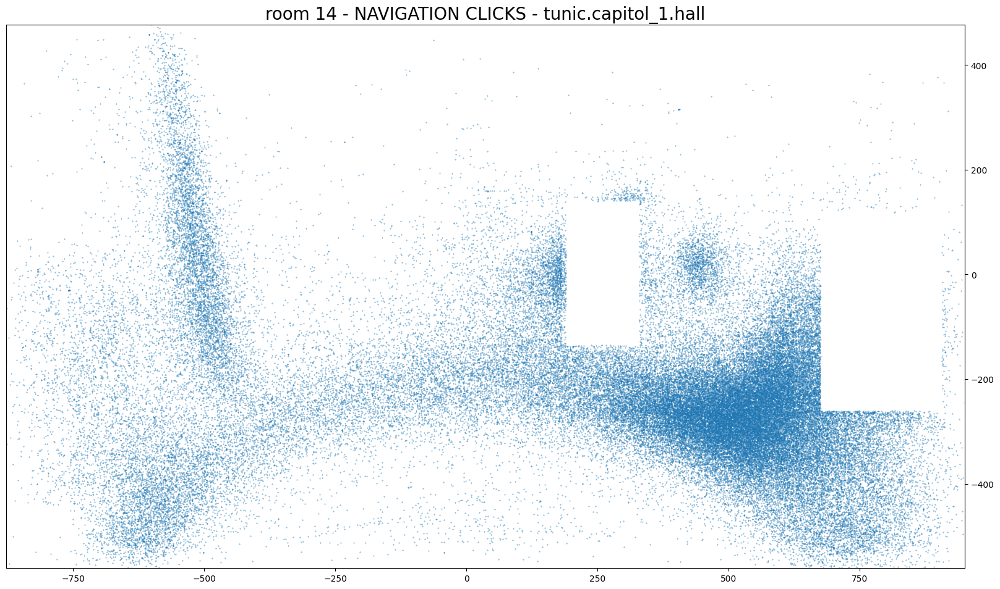

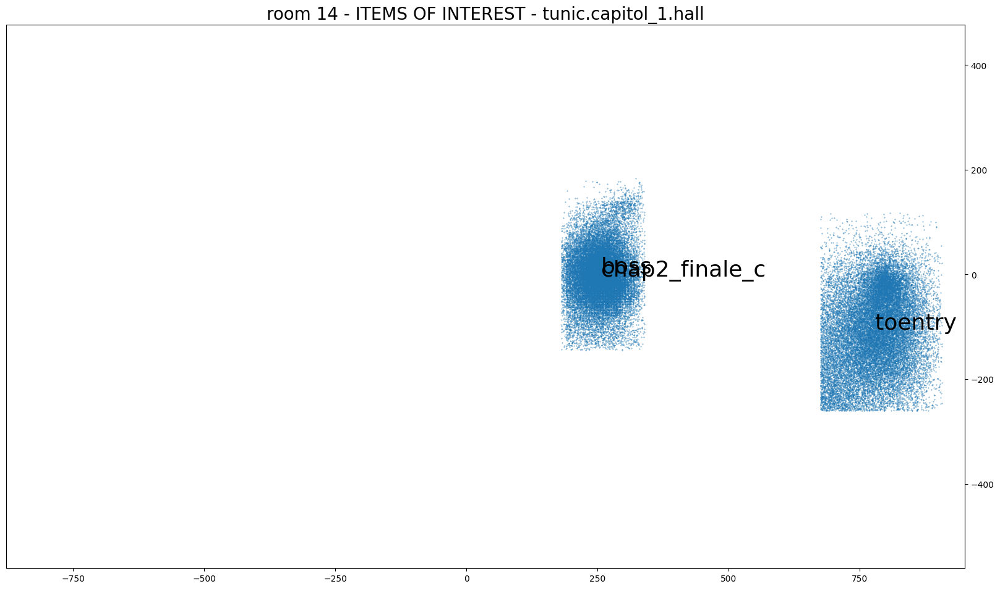

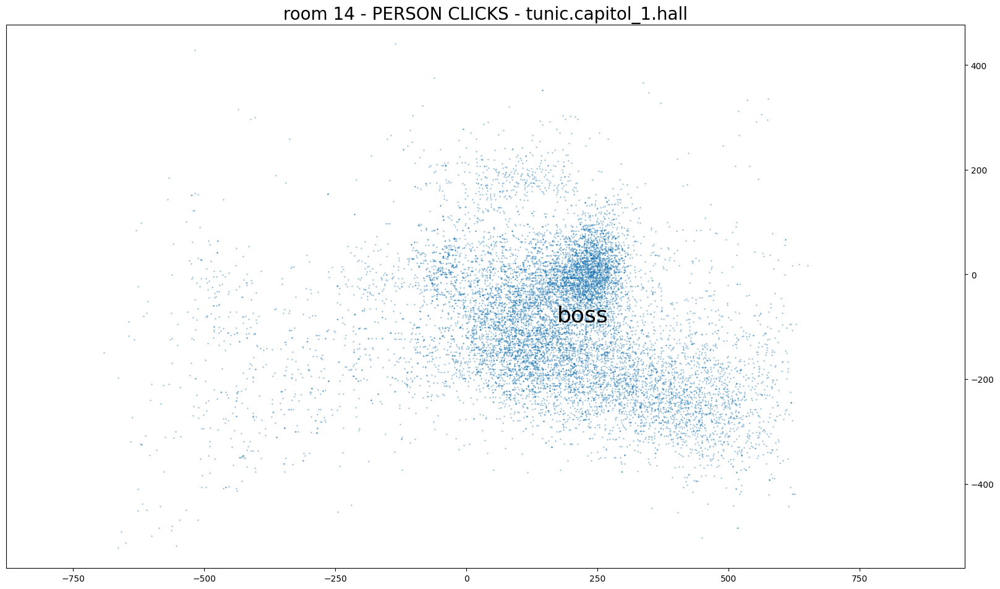



#########################
### ROOM 15: tunic.historicalsociety.cage
#########################


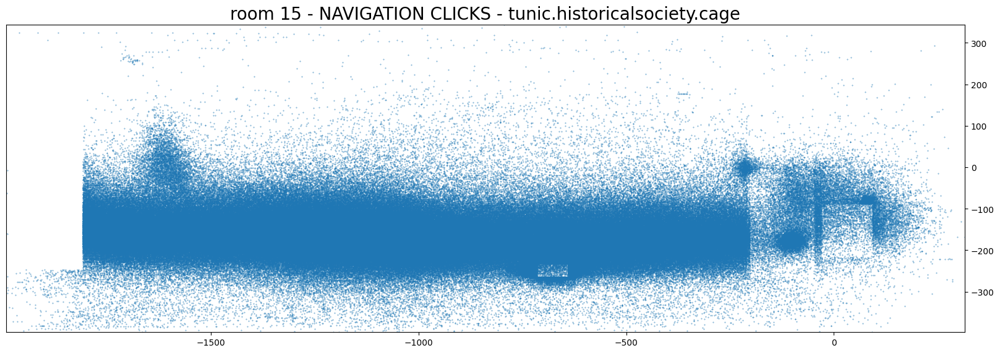

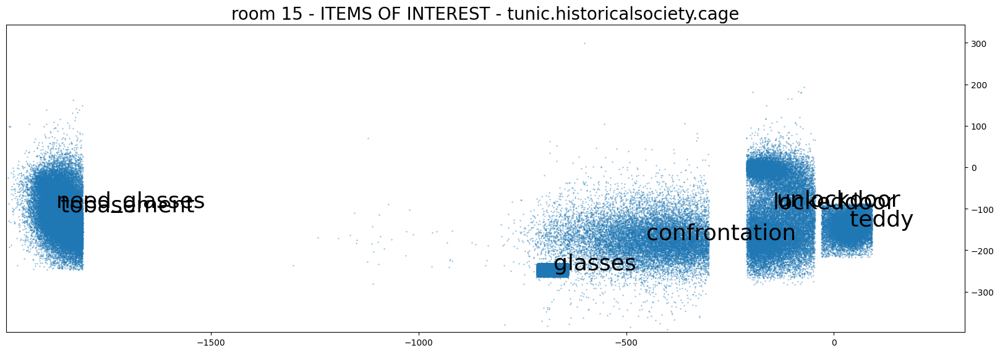

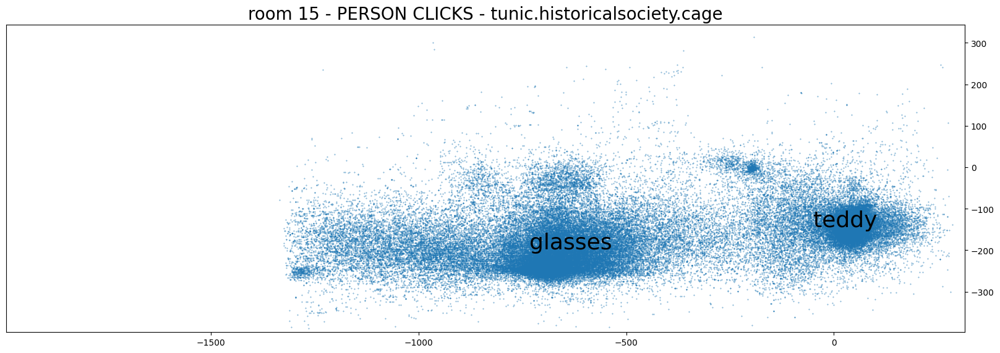



#########################
### ROOM 16: tunic.historicalsociety.collection_flag
#########################


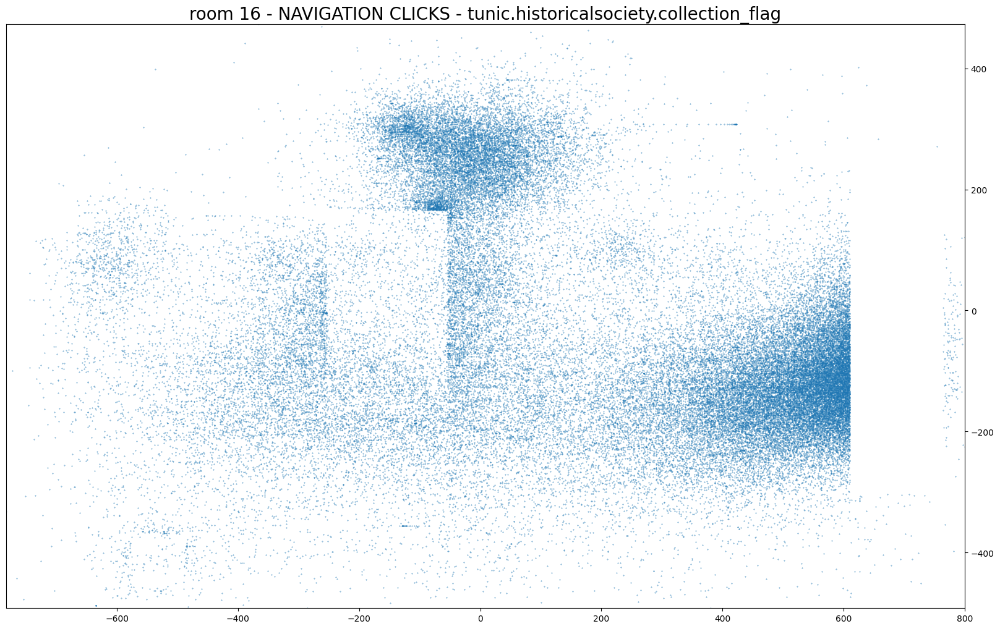

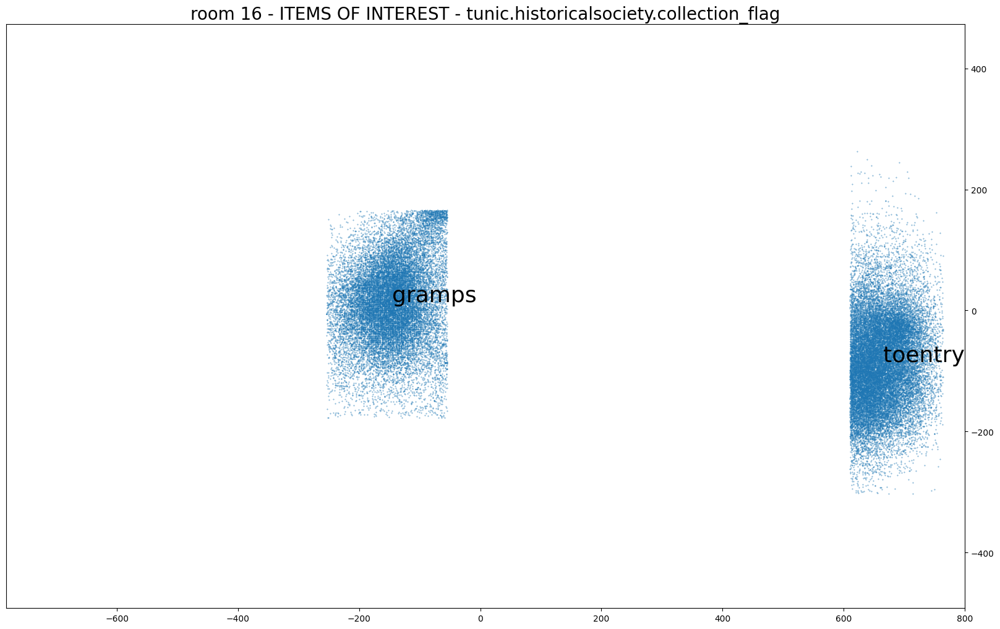

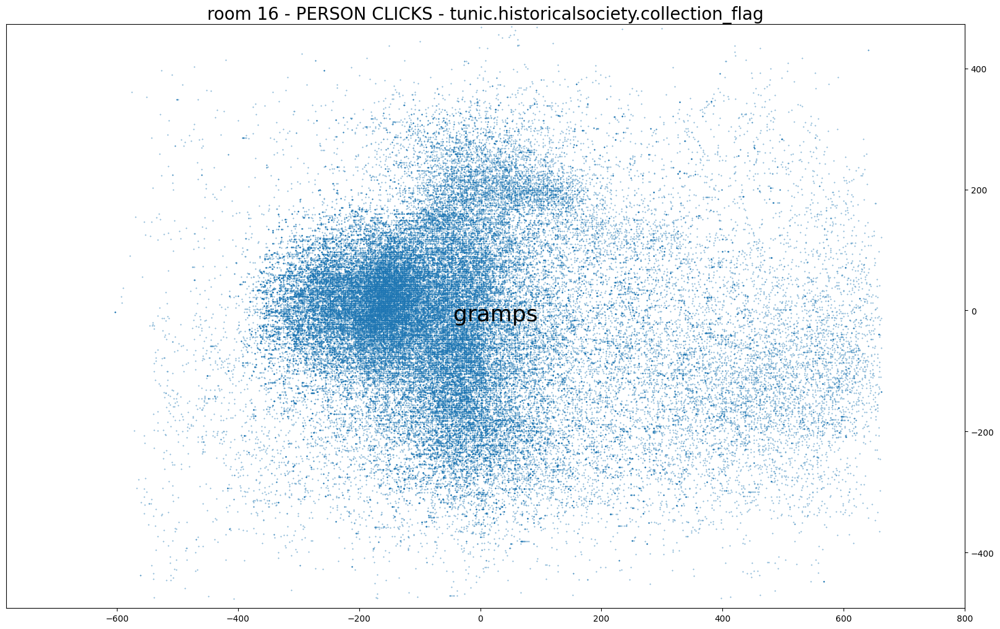



#########################
### ROOM 17: tunic.wildlife.center
#########################


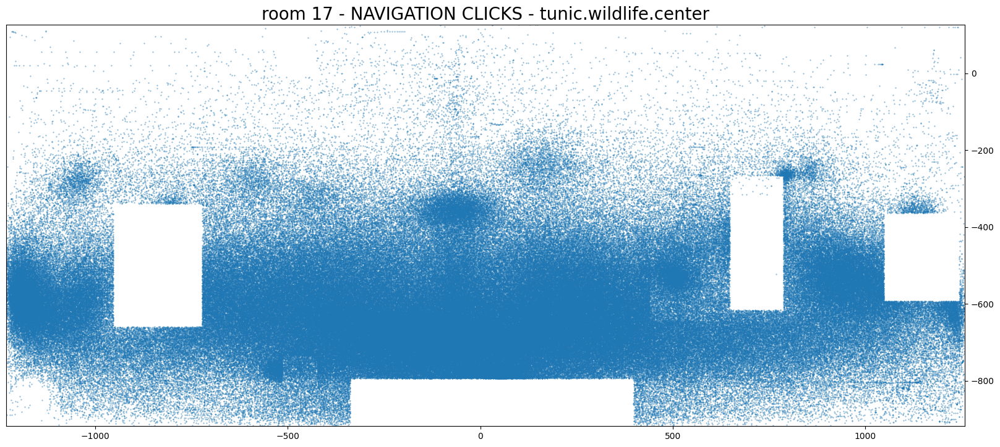

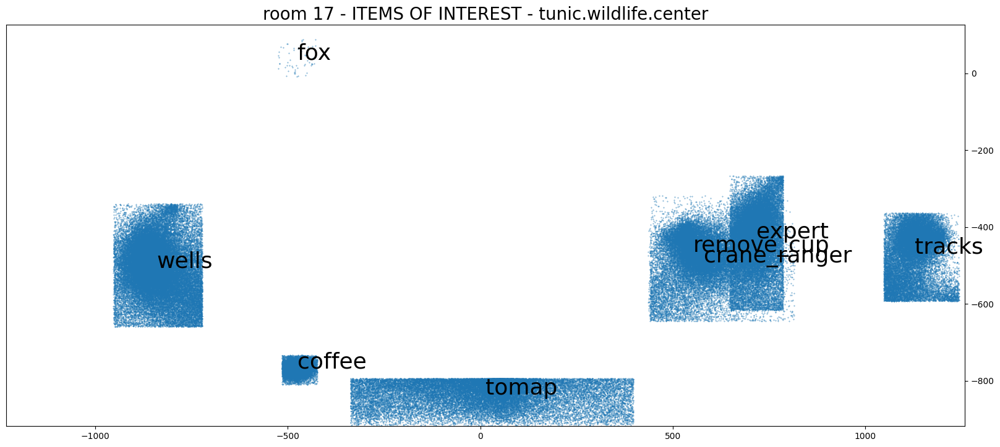

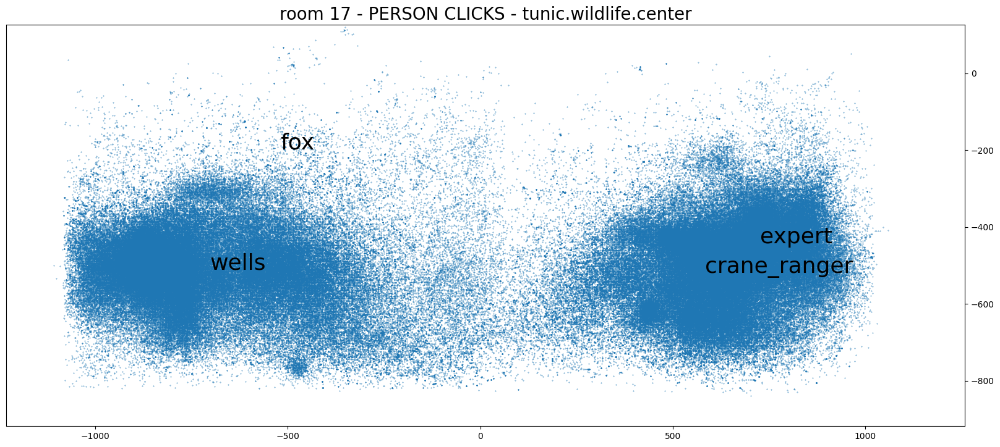



#########################
### ROOM 18: tunic.flaghouse.entry
#########################


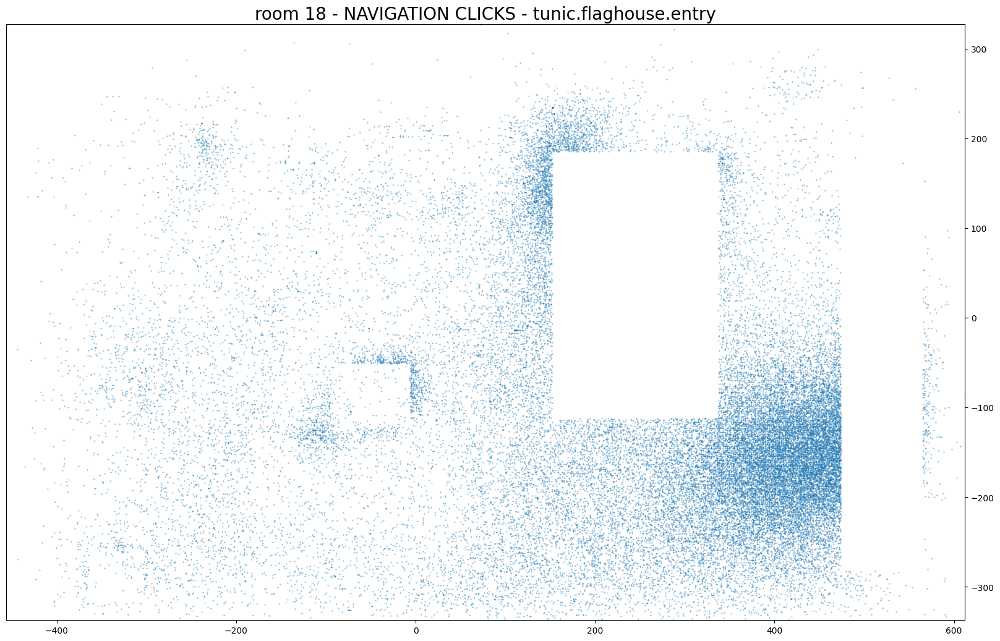

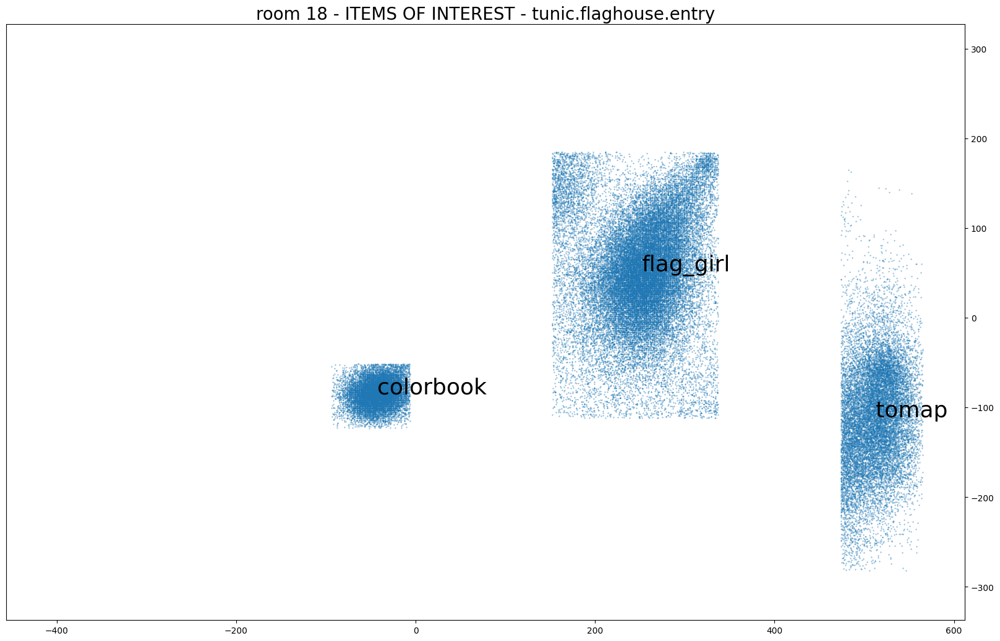

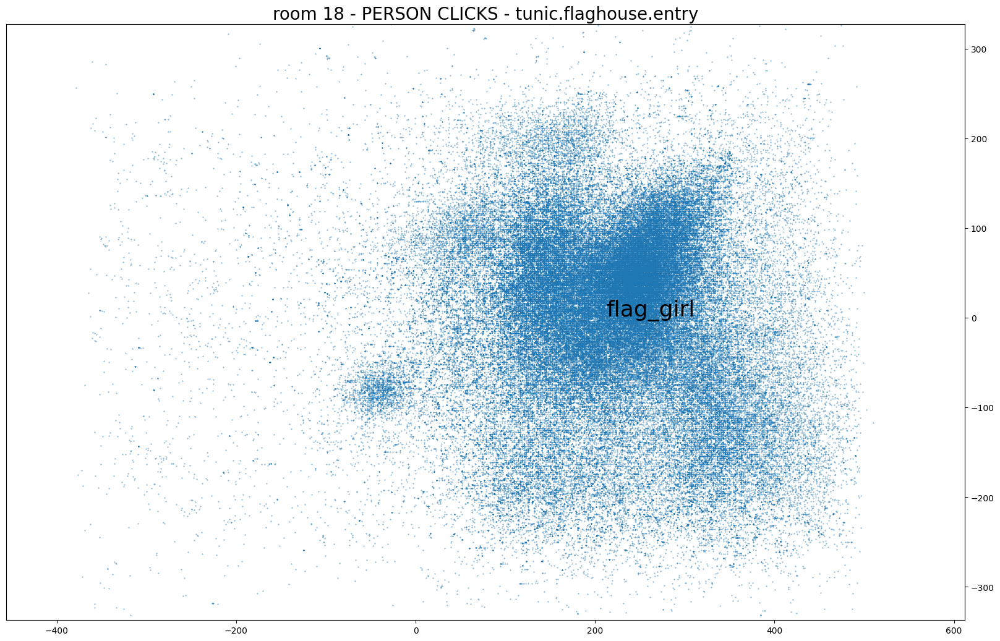



#########################
### ROOM 19: tunic.capitol_2.hall
#########################


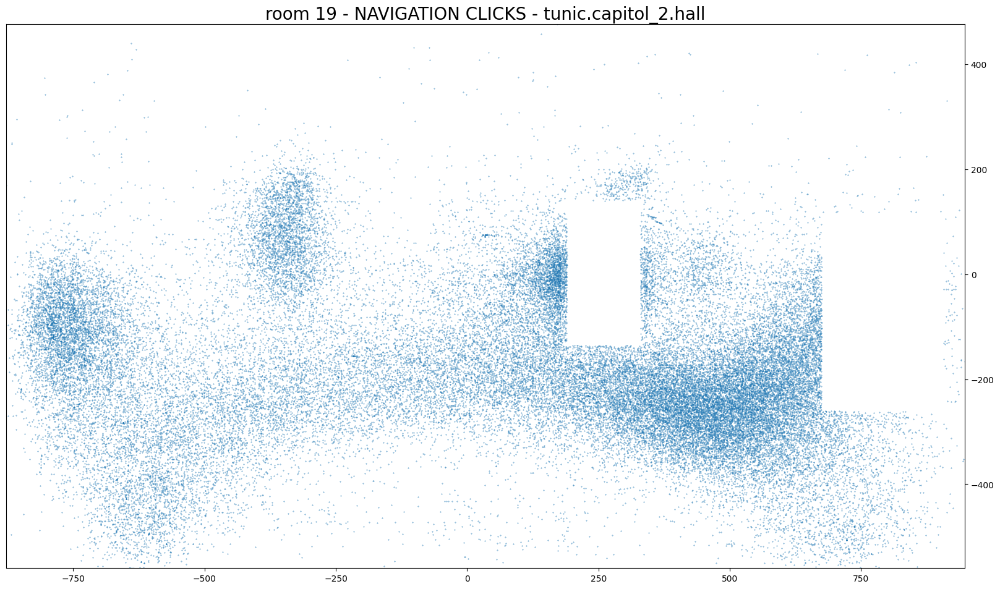

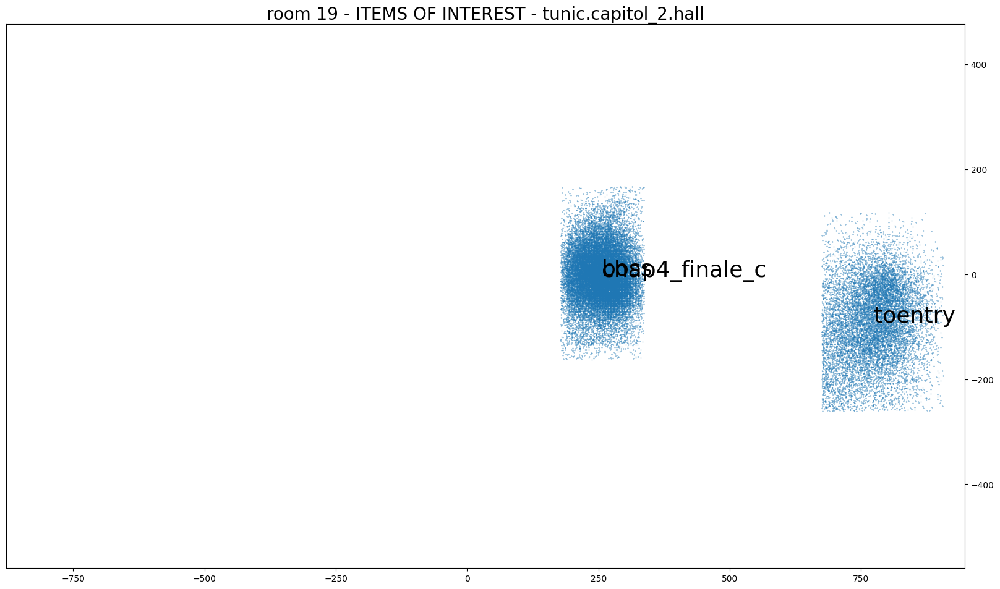

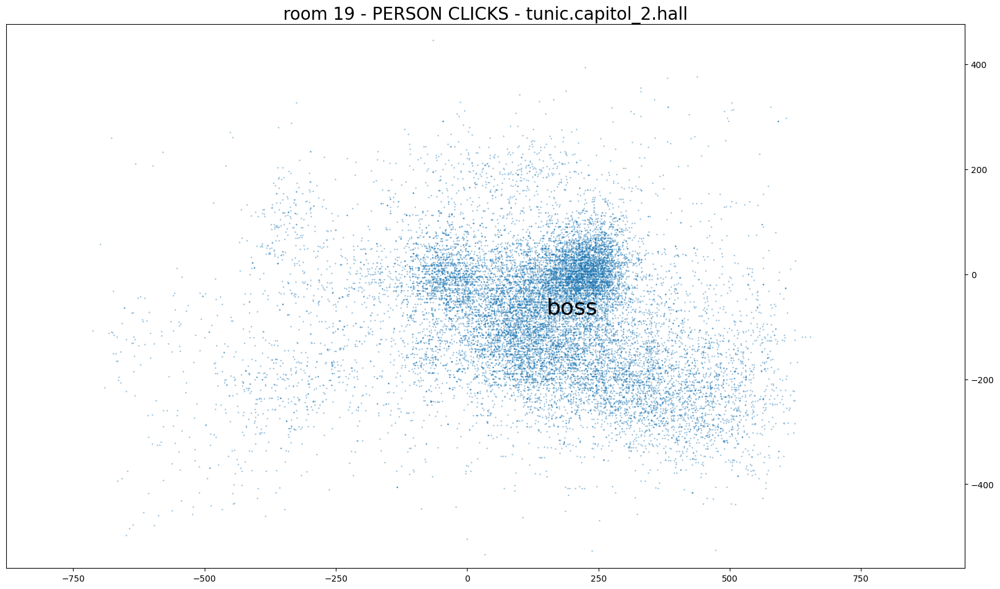

In [11]:
# DICTIONARY TO IMAGE PATHS
dd = {}
# PATH = '/kaggle/input/kaggle-game-images/'
# dd['tunic.historicalsociety.closet'] = Image.open(PATH+'closet.png')
# dd['tunic.historicalsociety.basement'] = Image.open(PATH+'basement.png')
# dd['tunic.historicalsociety.entry'] = Image.open(PATH+'entry.png')
# dd['tunic.historicalsociety.collection'] = Image.open(PATH+'collection.png')
# dd['tunic.historicalsociety.stacks'] = Image.open(PATH+'stacks.png')
# dd['tunic.kohlcenter.halloffame'] = Image.open(PATH+'halloffame.png')
# dd['tunic.capitol_0.hall'] = Image.open(PATH+'capitol_hall.png')
# dd['tunic.historicalsociety.closet_dirty'] = Image.open(
#     PATH+'dirty_closet.png')
# dd['tunic.historicalsociety.frontdesk'] = Image.open(PATH+'frontdesk.png')
# dd['tunic.humanecology.frontdesk'] = Image.open(PATH+'humanecology.png')
# dd['tunic.drycleaner.frontdesk'] = Image.open(PATH+'drycleaner.png')
# dd['tunic.library.frontdesk'] = Image.open(PATH+'library.png')
# dd['tunic.library.microfiche'] = Image.open(PATH+'microfiche.png')
# dd['tunic.capitol_1.hall'] = Image.open(PATH+'capitol_hall.png')
# dd['tunic.historicalsociety.cage'] = Image.open(PATH+'cage.png')
# dd['tunic.historicalsociety.collection_flag'] = Image.open(
#     PATH+'collection_flag.png')
# dd['tunic.wildlife.center'] = Image.open(PATH+'wildlife.png')
# dd['tunic.flaghouse.entry'] = Image.open(PATH+'flaghouse.png')
# dd['tunic.capitol_2.hall'] = Image.open(PATH+'capitol_hall.png')

# ITERATE ROOMS AND DISPLAY IMAGES AND SCATTER PLOTS
for j, rm in enumerate(ROOMS):
    print('\n')
    print('#'*25)
    print(f'### ROOM {j+1}:', rm)
    print('#'*25)

    # DISPLAY NAVIGATION CLICKS
    df = train.loc[(train.event_name == 'navigate_click')
                   & (train.room_fqid == rm) & (train.fqid.isna())]
    x_min, y_min = df[['room_coor_x', 'room_coor_y']].min().values
    x_max, y_max = df[['room_coor_x', 'room_coor_y']].max().values
    plt.figure(figsize=(20, 20))
    plt.scatter(df.room_coor_x, df.room_coor_y, s=0.1)
    plt.xlim((x_min, x_max))
    plt.ylim((y_min, y_max))
    plt.gca().set_aspect('equal')
    plt.title(f'room {j+1} - NAVIGATION CLICKS - {rm}', size=20)
    plt.gca().yaxis.tick_right()
    plt.show()

    # DISPLAY IMAGE
    if rm in dd:
        plt.figure(figsize=(17, 17))
        plt.imshow(dd[rm])
        plt.axis('off')
        plt.show()

    # DISPLAY ITEMS OF INTEREST
    df = train.loc[(train.event_name == 'navigate_click')
                   & (train.room_fqid == rm) & (train.fqid.notna())]
    ITEMS = df.fqid.unique()
    plt.figure(figsize=(20, 20))
    plt.scatter(df.room_coor_x, df.room_coor_y, s=0.1)
    for i in ITEMS:
        mns = df.loc[df.fqid == i, [
            'room_coor_x', 'room_coor_y']].mean().values
        plt.text(mns[0], mns[1], i, fontsize=26)
    plt.xlim((x_min, x_max))
    plt.ylim((y_min, y_max))
    plt.gca().set_aspect('equal')
    plt.title(f'room {j+1} - ITEMS OF INTEREST - {rm}', size=20)
    plt.gca().yaxis.tick_right()
    plt.show()

    # DISPLAY PERSON CLICKS
    df = train.loc[(train.event_name == 'person_click')
                   & (train.room_fqid == rm) & (train.fqid.notna())]
    if len(df) != 0:
        ITEMS = df.fqid.unique()
        plt.figure(figsize=(20, 20))
        plt.scatter(df.room_coor_x, df.room_coor_y, s=0.1)
        for i in ITEMS:
            mns = df.loc[df.fqid == i, [
                'room_coor_x', 'room_coor_y']].mean().values
            plt.text(mns[0], mns[1], i, fontsize=26)
        plt.xlim((x_min, x_max))
        plt.ylim((y_min, y_max))
        plt.gca().set_aspect('equal')
        plt.title(f'room {j+1} - PERSON CLICKS - {rm}', size=20)
        plt.gca().yaxis.tick_right()
        plt.show()


In [6]:
# train의 특성중 유의미한 특성들을 고름

# 오브젝트 타입이라 nunique를 써서 고유값의 수로만 묶음
NUNIQUE = ['room_fqid', 'text','fqid']
# 시간,좌표,페이지를 평균과 표준편차로 묶음
MMS = ['elapsed_time', 'hover_duration','page','room_coor_x', 'room_coor_y','screen_coor_x','screen_coor_y']
# 시간을 최대 최소 값으로 묶음
TIME = ['elapsed_time', 'hover_duration']

# train.event_name의 고유 값들을 총합으로 묶음
EVENTS = ['navigate_click','person_click','cutscene_click','object_click','notification_click',
          'map_click','observation_click','checkpoint','map_hover','notebook_click']

In [7]:
# train을 섹션아이디, 레벨그룹, 레벨로 묶어주는 함수

def feature_engineer(train):
    dfs = []
    for c in NUNIQUE:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('nunique')
        tmp.name = tmp.name + '_nunique'
        dfs.append(tmp)
    for c in MMS:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('mean')
        tmp.name = tmp.name + '_mean'
        dfs.append(tmp)
    for c in MMS:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('std')
        tmp.name = tmp.name + '_std'
        dfs.append(tmp)  
        
    for c in TIME:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('max')
        tmp.name = tmp.name + '_max'
        dfs.append(tmp) 
    for c in TIME:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('min')
        tmp.name = tmp.name + '_min'
        dfs.append(tmp) 

    for c in EVENTS:
        train[c] = (train.event_name == c).astype('int8')
    for c in EVENTS + ['elapsed_time','hover_duration','index']:
        tmp = train.groupby(['session_id','level_group','level'])[c].agg('sum')
        tmp.name = tmp.name + '_sum'
        dfs.append(tmp)
    train = train.drop(EVENTS,axis=1)
    df = pd.concat(dfs,axis=1)
    df = df.fillna(-1)
    df = df.reset_index()
    df = df.set_index('session_id')
    return df

In [8]:
%%time
df = feature_engineer(train)
print( df.shape )
df.head()

(270626, 36)
CPU times: total: 21.1 s
Wall time: 50.9 s


,level_group,level,room_fqid_nunique,text_nunique,fqid_nunique,elapsed_time_mean,hover_duration_mean,page_mean,room_coor_x_mean,room_coor_y_mean,...,object_click_sum,notification_click_sum,map_click_sum,observation_click_sum,checkpoint_sum,map_hover_sum,notebook_click_sum,elapsed_time_sum,hover_duration_sum,index_sum
session_id,,,,,,,,,,,,,,,,,,,,,
20090312431273200,0-4,0,1,12,5,12741.821429,0.000000,-1.0,-77.966370,-170.396023,...,1,1,0,1,0,0,0,356771,0.0,378
20090312431273200,0-4,1,3,19,6,47940.750000,246.843750,-1.0,39.681021,-49.921726,...,3,3,0,1,0,0,0,1534104,7899.0,1392
20090312431273200,0-4,2,2,22,8,84409.692308,111.512821,-1.0,-30.656928,-18.994902,...,4,2,0,0,0,0,0,3291978,4349.0,3081
20090312431273200,0-4,3,6,7,13,129464.452830,124.547170,-1.0,121.772627,-69.675476,...,3,2,1,2,0,2,0,6861616,6601.0,6625
20090312431273200,0-4,4,2,0,5,162420.615385,20.538462,-1.0,-241.820346,-26.027660,...,0,0,1,0,1,2,0,2111468,267.0,2054


In [ ]:
FEATURES = df_copy1.columns[1:]
print(f'{len(FEATURES)}개의 특성')
ALL_USERS = df_copy1.index.unique()
print(f'{len(ALL_USERS)}명의 유저 정보')

In [23]:
df.columns[1:]

Index(['level', 'room_fqid_nunique', 'text_nunique', 'fqid_nunique',
       'elapsed_time_mean', 'hover_duration_mean', 'page_mean',
       'room_coor_x_mean', 'room_coor_y_mean', 'screen_coor_x_mean',
       'screen_coor_y_mean', 'elapsed_time_std', 'hover_duration_std',
       'page_std', 'room_coor_x_std', 'room_coor_y_std', 'screen_coor_x_std',
       'screen_coor_y_std', 'elapsed_time_max', 'hover_duration_max',
       'elapsed_time_min', 'hover_duration_min', 'navigate_click_sum',
       'person_click_sum', 'cutscene_click_sum', 'object_click_sum',
       'notification_click_sum', 'map_click_sum', 'observation_click_sum',
       'checkpoint_sum', 'map_hover_sum', 'notebook_click_sum',
       'elapsed_time_sum', 'hover_duration_sum', 'index_sum'],
      dtype='object')

In [45]:
# df.column들

feature = ['level', 'room_fqid_nunique', 'text_nunique', 'fqid_nunique', 'elapsed_time_mean', 
           'hover_duration_mean', 'page_mean', 'room_coor_x_mean', 'room_coor_y_mean',
       'screen_coor_x_mean', 'screen_coor_y_mean', 'elapsed_time_std',
       'hover_duration_std', 'page_std', 'room_coor_x_std',
       'room_coor_y_std', 'screen_coor_x_std', 'screen_coor_y_std',
       'navigate_click_sum', 'person_click_sum', 'cutscene_click_sum',
       'object_click_sum', 'notification_click_sum', 'map_click_sum',
       'observation_click_sum', 'checkpoint_sum', 'map_hover_sum',
       'notebook_click_sum', 'elapsed_time_sum', 'hover_duration_sum',
       'index_sum']

In [9]:
# df를 섹션아이디, 레벨그룹로 묶어주는 함수

def df_feature_engineer(df):
    dfs = []
    for c in feature:
        tmp = df.groupby(['session_id','level_group'])[c].agg('mean')
        tmp.name = tmp.name + '_mean'
        dfs.append(tmp)
    for c in feature:
        tmp = df.groupby(['session_id','level_group'])[c].agg('std')
        tmp.name = tmp.name + '_std'
        dfs.append(tmp)
    for c in feature:
        tmp = df.groupby(['session_id','level_group'])[c].agg('max')
        tmp.name = tmp.name + '_max'
        dfs.append(tmp)
    for c in feature:
        tmp = df.groupby(['session_id','level_group'])[c].agg('min')
        tmp.name = tmp.name + '_min'
        dfs.append(tmp)
    for c in feature:
        tmp = df.groupby(['session_id','level_group'])[c].agg('sum')
        tmp.name = tmp.name + '_sum'
        dfs.append(tmp)
        
    df_df = pd.concat(dfs,axis=1)
    df_df = df_df.reset_index()
    df_df = df_df.set_index('session_id')
    return df_df

In [10]:
df_df = df_feature_engineer(df)

In [46]:
FEATURES = df_copy1.columns[1:]
print(f'{len(FEATURES)}개의 특성')
ALL_USERS = df_copy1.index.unique()
print(f'{len(ALL_USERS)}명의 유저 정보')

NameError: name 'df_copy1' is not defined

# Train XGBoost Model

18개의 질문 각각에 대해 하나의 모델을 훈련시킵니다.   
또한, level_groups = '0-4'의 데이터를 사용하여 질문 1-3에 대한 모델을 교육하고,  
질문 4-13에 대한 레벨 그룹 '5-12'와 질문 14-18에 대한 레벨 그룹 '13-22'를 사용합니다.   
왜냐하면 테스트 추론 중에 카글의 추론 API로부터 (해당 질문을 예측하기 위해)얻는 데이터이기 때문입니다.   
이전 level_groups에서 사용자의 이전 데이터를 저장하고   
이를 사용하여 미래 level_groups를 예측하여 모델을 개선할 수 있습니다.  

In [12]:
gkf = GroupKFold(n_splits=5)
oof = pd.DataFrame(data=np.zeros((len(ALL_USERS),18)), index=ALL_USERS)
models = {}

# COMPUTE CV SCORE WITH 5 GROUP K FOLD
for i, (train_index, test_index) in enumerate(gkf.split(X=df_df, groups=df_df.index)):
    print(' ')
    print('Fold',i+1)
    print(' ')
    
    xgb_params = {
    'objective' : 'binary:logistic',
    'eval_metric':'logloss',
    'learning_rate': 0.05,
    'max_depth': 4,
    'n_estimators': 1000,
    'early_stopping_rounds': 50,
    'tree_method':'hist',
    'subsample':0.8,
    'colsample_bytree': 0.58}
    
    # ITERATE THRU QUESTIONS 1 THRU 18
    for t in range(1,19):
        
        # USE THIS TRAIN DATA WITH THESE QUESTIONS
        if t<=3: grp = '0-4'
        elif t<=13: grp = '5-12'
        else: grp = '13-22'
            
        # TRAIN DATA
        train_x = df_df.iloc[train_index]
        train_x = train_x.loc[train_x.level_group == grp]
        train_users = train_x.index.values
        train_y = targets.loc[targets.q==t].set_index('session').loc[train_users]
        
        # VALID DATA
        valid_x = df_df.iloc[test_index]
        valid_x = valid_x.loc[valid_x.level_group == grp]
        valid_users = valid_x.index.values
        valid_y = targets.loc[targets.q==t].set_index('session').loc[valid_users]
        
        # TRAIN MODEL        
        clf =  XGBClassifier(**xgb_params)
        clf.fit(train_x[FEATURES].astype('float32'), train_y['correct'],
                eval_set=[ (valid_x[FEATURES].astype('float32'), valid_y['correct']) ],
                verbose=0)
        print(f'{t}({clf.best_ntree_limit}), ',end='')
        
        # SAVE MODEL, PREDICT VALID OOF
        models[f'{grp}_{t}'] = clf
        oof.loc[valid_users, t-1] = clf.predict_proba(valid_x[FEATURES].astype('float32'))[:,1]
        
    print()

 
Fold 1
 
1(88), 2(128), 3(96), 4(174), 5(122), 6(112), 7(73), 8(139), 9(73), 10(84), 11(97), 12(131), 13(182), 14(165), 15(134), 16(54), 17(69), 18(187), 
 
Fold 2
 
1(173), 2(97), 3(113), 4(99), 5(109), 6(91), 7(178), 8(45), 9(95), 10(83), 11(75), 12(97), 13(81), 14(98), 15(71), 16(90), 17(47), 18(107), 
 
Fold 3
 
1(110), 2(112), 3(172), 4(175), 5(82), 6(61), 7(104), 8(65), 9(95), 10(58), 11(45), 12(75), 13(112), 14(227), 15(73), 16(90), 17(75), 18(140), 
 
Fold 4
 
1(188), 2(101), 3(96), 4(106), 5(115), 6(100), 7(201), 8(52), 9(106), 10(45), 11(111), 12(121), 13(65), 14(135), 15(90), 16(47), 17(60), 18(122), 
 
Fold 5
 
1(204), 2(125), 3(123), 4(103), 5(97), 6(101), 7(63), 8(65), 9(77), 10(56), 11(87), 12(104), 13(92), 14(89), 15(190), 16(62), 17(77), 18(75), 


# Compute CV Score

예측 확률을 1과 0으로 변환해야 합니다. 경기 측정 기준은 정밀도와 리콜의 조화 평균인 F1 점수입니다.   
1을 예측할 때 p > 임계값에 대한 최적의 임계값과 F1 점수를 최대화하기 위해 0을 예측할 때의 임계값을 알아보겠습니다.  

In [13]:
true = oof.copy()
for k in range(18):
    # GET TRUE LABELS
    tmp = targets.loc[targets.q == k+1].set_index('session').loc[ALL_USERS]
    true[k] = tmp.correct.values

In [32]:
# 확률을 1과 0으로 변환하기 위한 최적의 임계값을 찾습니다
scores = []; thresholds = []
best_score = 0; best_threshold = 0

for threshold in np.arange(0.4,0.81,0.01):
    preds = (oof.values.reshape((-1))>threshold).astype('int')
    m = f1_score(true.values.reshape((-1)), preds, average='macro')   
    scores.append(m)
    thresholds.append(threshold)
    if m>best_score:
        best_score = m
        best_threshold = threshold
# print(f'Best 임계점: {best_threshold:.2f}')
# print(f'Best F1_score: {best_score:.4f}')

In [15]:
print('When using optimal threshold...')
for k in range(18):
        
    # COMPUTE F1 SCORE PER QUESTION
    m = f1_score(true[k].values, (oof[k].values>best_threshold).astype('int'), average='macro')
    print(f'Q{k}: F1 =',m)
    
# COMPUTE F1 SCORE OVERALL
m = f1_score(true.values.reshape((-1)), (oof.values.reshape((-1))>best_threshold).astype('int'), average='macro')
print('==> Overall F1 =',m)

When using optimal threshold...
Q0: F1 = 0.6004347276373642
Q1: F1 = 0.4946153516111039
Q2: F1 = 0.4847791024759316
Q3: F1 = 0.6149309693580576
Q4: F1 = 0.5999279516676181
Q5: F1 = 0.6006007000417892
Q6: F1 = 0.5896513060855458
Q7: F1 = 0.5510556371046487
Q8: F1 = 0.6015828279255682
Q9: F1 = 0.534577382122843
Q10: F1 = 0.5952908742018194
Q11: F1 = 0.498992462777868
Q12: F1 = 0.45284986300575736
Q13: F1 = 0.6136967967572022
Q14: F1 = 0.5286022846710755
Q15: F1 = 0.4432202024204994
Q16: F1 = 0.5293465491872871
Q17: F1 = 0.4904368831075225
==> Overall F1 = 0.6801051538929606


기본
==> Overall F1 = 0.6801051538929606

In [16]:
# # IMPORT KAGGLE API
# import jo_wilder
# env = jo_wilder.make_env()
# iter_test = env.iter_test()

# # CLEAR MEMORY
# import gc
# del train, targets, df, oof, true
# _ = gc.collect()

In [17]:
# limits = {'0-4':(1,4), '5-12':(4,14), '13-22':(14,19)}

# for (sample_submission, test) in iter_test:
    
#     test['room_coor_x'] = test['room_coor_x'].fillna(0)
#     test['room_coor_y'] = test['room_coor_y'].fillna(0)
#     test['screen_coor_x'] = test['screen_coor_x'].fillna(0)
#     test['screen_coor_y'] = test['screen_coor_y'].fillna(0)
#     test['hover_duration'] = test['hover_duration'].fillna(0)
#     test['page'] = test['page'].fillna(-1)

#     # FEATURE ENGINEER TEST DATA
#     df = feature_engineer(test)

#     df_df = df_feature_engineer(df)

#     # INFER TEST DATA
#     grp = test.level_group.values[0]
#     a,b = limits[grp]
#     for t in range(a,b):
#         clf = models[f'{grp}_{t}']
#         p = clf.predict_proba(df_df[FEATURES].astype('float32'))[:,1]
#         mask = sample_submission.session_id.str.contains(f'q{t}')
#         sample_submission.loc[mask,'correct'] = int(p.item()>best_threshold)
    
#     env.predict(sample_submission)

In [18]:
# df = pd.read_csv('submission.csv')
# print( df.shape )
# df.head()

In [19]:
# print(df.correct.mean())